In [1]:
# Installation needed just once

! pip install plotly_express==0.4.0

<div style="padding:10px;background-color: cornflowerblue; color:white;font-size:24px;">Imports </div>

In [2]:
import sys
import requests
print(sys.version)
import numpy as np
print(np.__version__)
import pandas as pd
print(pd.__version__)

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.ticker as mtick
import plotly.express as px

# Additionals
import datetime as dt
from scipy.interpolate import interp1d
import warnings
warnings.filterwarnings('ignore')

3.8.8 (default, Apr 13 2021, 15:08:03) [MSC v.1916 64 bit (AMD64)]
1.20.1
1.2.4


<div style="padding:10px; background-color: cornflowerblue; color:white;font-size:24px;">
    Data Gathering, Cleaning & Creating</div>

<font color='cornflowerblue' size = 4>**Interesting Dates**</font>

In [3]:
# Make two dates lists because if loop through 20 months to make 20 scatterplots, takes up a lot of memory.
# We COULD keep all dates in one list and create them all in one loop.

stringe_measure_date = '2020-03-31' 

month_ends_2020 = ['2020-02-29','2020-03-31','2020-04-30','2020-05-31','2020-06-30',
                   '2020-07-31','2020-08-31','2020-09-30','2020-10-31','2020-11-30','2020-12-31']

month_ends_2021 = ['2021-01-31','2021-02-28','2021-03-31','2021-04-30','2021-05-31','2021-06-30',
                   '2021-07-31','2021-08-31','2021-09-30','2021-10-31','2021-11-30','2021-12-31']

<font color='cornflowerblue' size = 4>**Latitude - Longitude Data**</font>

In [4]:
try:    
    urlg= "https://raw.githubusercontent.com/albertyw/avenews/master/old/data/average-latitude-longitude-countries.csv"
    resp = requests.get(urlg)
    geo_data = pd.read_csv(urlg)
    geo_data = geo_data.rename(columns = {'Country': 'location'}, inplace = False)

    geo_data = geo_data.replace({"Brunei Darussalam": "Brunei",
                                 "Czech Republic": "Czechia",
                                 "Swaziland": "Eswatini", 
                                 "Iran, Islamic Republic of": "Iran",
                                 "Lao People's Democratic Republic": "Laos",
                                 "Libyan Arab Jamahiriya": "Libya",
                                 "Moldova, Republic of": "Moldova",
                                 "Russian Federation": "Russia",
                                 "Korea, Republic of": "South Korea",
                                 "Tanzania, United Republic of": "Tanzania"
                                })

    geo_data = geo_data.drop(columns = 'ISO 3166 Country Code')
    geo_data.to_csv('geo_data.csv')

except:
    print('URL does not work, we try read from local copy')
    try:
        geo_data = pd.read_csv('geo_data.csv')
    except:
        print('The local upload did not work either')
    
geo_data.head()

,location,Latitude,Longitude
0,Andorra,42.50,1.50
1,United Arab Emirates,24.00,54.00
2,Afghanistan,33.00,65.00
3,Antigua and Barbuda,17.05,-61.80
4,Anguilla,18.25,-63.17


<font color='cornflowerblue' size = 4>**COVID data**</font>

In [5]:
# Downloading and cleaning the data

try:
    urlc="https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/owid-covid-data.csv"
    covid_data = pd.read_csv(urlc, parse_dates=['date'])
    
    # Clean the data
    # Step 0
    # Check how many unique 'countries' we have, without any filtering.
    # We get 237, which matches Emanuel's results.
    num_countries_0 = covid_data.location.nunique()
    print('Start: Number of countries without any filter: ', num_countries_0)

    # Step 1
    # Take out entries that are not really countries. These begin with 'OWID-XXXX'. 
    # Countries all have three-letter abbreviation codes.
    clean_real_cty = covid_data[covid_data['iso_code'].apply(lambda x: len(x)==3)]
    print('# 1 : Number of real countries: ', clean_real_cty.location.nunique())

    # Step 2
    # Taking out countries with less than "n" observations
    # We have decided to use n=500 for now because when we did value_counts, we found 500 a good natural break
    # Lesotho has 550 observations, and the next country in terms of decreasing number of observations is Solomon Islands, which
    # only has 398 observations.
    num_obs = clean_real_cty.location.value_counts()
    num_obs[-44:-1]

    n = 500
    clean_500_obs = clean_real_cty[clean_real_cty['location'].map(clean_real_cty['location'].value_counts()) >= n]
    print('# 2 : Number of countries with over n observations: ', clean_500_obs.location.nunique())
    
    # Steps 3-10
    # We cut countries without any data in the following variables:
    # 'stringency_index','new_cases_smoothed_per_million','new_deaths_smoothed_per_million','population_density',
    # 'gdp_per_capita','human_development_index','aged_65_older','hospital_beds_per_thousand'

    filters = ['stringency_index','new_cases_smoothed_per_million','new_deaths_smoothed_per_million','population_density',
               'gdp_per_capita','human_development_index','aged_65_older','hospital_beds_per_thousand']

    df = clean_500_obs
    i = 3
    for f in filters:
        has_index = df[df[f].isnull() == False]
        clean_index =  df[df['location'].isin(has_index['location'].drop_duplicates())]
        num_index = clean_index['location'].nunique()
        print('#',i,': Countries with some ', f, 'data: ', num_index)
        miss_index = df[df['location'].isin(has_index['location'].drop_duplicates()) == False]
        num_no_index = miss_index['location'].nunique() 
        print('\tCountries with no ' + f + ' data at all: ', num_no_index)
        df = clean_index
        i+=1

    # Step 11
    # We decided to divide countries into subgroups based on initial stringency measure.
    # We define initial stringency measure as the country's stringency index on March 31, 2021.
    # We cut countries without stringency data on March 31, 2021, of which there are 2.
    # We have 144 resulting countries.
    clean_hosp = df
    has_3_31 = clean_hosp[clean_hosp['date']=='2020-03-31'].location.drop_duplicates()
    by_3_31 = clean_hosp[clean_hosp.location.isin(has_3_31)]
    print('# 11: Countries with stringency data as of 3/31/20: ', by_3_31.location.nunique())
    
    # We will read out the ending clean dataframe into a new csv, then read back in.
    # The new csv, owid-covid-clean.csv, is the version uploaded into github.
    # We need the new csv file to be less than 25mb, so we are removing some columns we do not need
    clean_data = by_3_31.drop(columns = ['reproduction_rate', 'icu_patients', 'icu_patients_per_million', 'hosp_patients',
                                         'hosp_patients_per_million', 'weekly_icu_admissions', 
                                         'weekly_icu_admissions_per_million', 'weekly_hosp_admissions', 
                                         'weekly_hosp_admissions_per_million', 'new_tests', 'total_tests', 
                                         'total_tests_per_thousand', 'new_tests_per_thousand', 'population',
                                         'new_tests_smoothed', 'new_tests_smoothed_per_thousand', 'tests_per_case',
                                         'tests_units', 'median_age', 'aged_70_older', 'extreme_poverty',
                                         'excess_mortality_cumulative_absolute', 'excess_mortality_cumulative', 
                                         'excess_mortality', 'excess_mortality_cumulative_per_million', 'new_cases', 'new_deaths',
                                         'new_cases_smoothed', 'new_deaths_smoothed_per_million', 'new_cases_smoothed_per_million',
                                         'new_deaths_smoothed','total_boosters', 'total_boosters_per_hundred', 'female_smokers', 
                                         'male_smokers','handwashing_facilities', 'life_expectancy', 'new_vaccinations_smoothed', 
                                         'new_vaccinations_smoothed_per_million', 'new_people_vaccinated_smoothed',
                                         'new_people_vaccinated_smoothed_per_hundred'])
    
    clean_data["continent"] = clean_data["continent"].replace({'South America': 'America',
                                                               'North America': 'America'})
    
    clean_data.to_csv('owid-covid-clean.csv')
    
except:
    # Instructor can choose to download the csv we uploaded into github
    # If the URL link above doesn't work, we will read from the local copy
    print('URL does not work, we try read from local copy')
    try:
        clean_data = pd.read_csv('owid-covid-clean.csv', parse_dates=['date'])
    except:
        print('The local upload did not work either')

Start: Number of countries without any filter:  238
# 1 : Number of real countries:  223
# 2 : Number of countries with over n observations:  203
# 3 : Countries with some  stringency_index data:  176
	Countries with no stringency_index data at all:  27
# 4 : Countries with some  new_cases_smoothed_per_million data:  176
	Countries with no new_cases_smoothed_per_million data at all:  0
# 5 : Countries with some  new_deaths_smoothed_per_million data:  175
	Countries with no new_deaths_smoothed_per_million data at all:  1
# 6 : Countries with some  population_density data:  172
	Countries with no population_density data at all:  3
# 7 : Countries with some  gdp_per_capita data:  165
	Countries with no gdp_per_capita data at all:  7
# 8 : Countries with some  human_development_index data:  162
	Countries with no human_development_index data at all:  3
# 9 : Countries with some  aged_65_older data:  161
	Countries with no aged_65_older data at all:  1
# 10 : Countries with some  hospital_b

In [6]:
country_list = clean_data['location'].unique()
for country in list(country_list):
    x = clean_data[clean_data['location'] == country].index[0]
    clean_data.loc[x] = clean_data.loc[x].fillna(0)
    
# Variables that need the previous data
clean_data['stringency_index'].fillna(method='ffill', inplace=True)
clean_data['total_vaccinations'].fillna(method='ffill', inplace=True) 
clean_data['people_vaccinated'].fillna(method='ffill', inplace=True) 
clean_data['people_fully_vaccinated'].fillna(method='ffill', inplace=True) 
clean_data['people_vaccinated_per_hundred'].fillna(method='ffill', inplace=True) 
clean_data['people_fully_vaccinated_per_hundred'].fillna(method='ffill', inplace=True)

In [7]:
# We look at the stringency index across countries as of Mar 31, 2021 and see if they can be divided into natural subgroups.
# From here, it seems that there are similar number of countries with stringency index above 90, in the 80s, in the 70s, and
# below 70.
max_str = clean_data[clean_data.date <= stringe_measure_date].groupby('location')['stringency_index'].max()
print((max_str//10).value_counts())
just_stringe_date = pd.DataFrame(max_str)
just_stringe_date

8.0     47
7.0     36
9.0     22
5.0     12
6.0     11
10.0     8
4.0      4
1.0      2
0.0      1
3.0      1
Name: stringency_index, dtype: int64


,stringency_index
location,
Afghanistan,67.59
Albania,84.26
Algeria,86.57
Argentina,100.00
Australia,71.30
...,...
Uzbekistan,90.74
Venezuela,82.41
Vietnam,83.33


In [8]:
# We separate the countries into the four groups per stringency index.
# Decided not to use pd.cut here because not assigning individual rows a category based on stringency, but rather
# only on stringency on Mar 31, 2020

ultra = just_stringe_date[just_stringe_date.stringency_index >= 90].index.unique()
print(len(ultra), ' ultra', ultra)

high = just_stringe_date[(just_stringe_date.stringency_index >= 80) & (just_stringe_date.stringency_index < 90)].index.unique()
print(len(high), ' high', high)

med = just_stringe_date[(just_stringe_date.stringency_index >= 70) & (just_stringe_date.stringency_index < 80)].index.unique()
print(len(med), ' med', med)

low = just_stringe_date[(just_stringe_date.stringency_index < 70)].index.unique()
print(len(low), ' low', low)

30  ultra Index(['Argentina', 'Bahamas', 'Bolivia', 'Croatia', 'Cyprus', 'Djibouti',
       'Dominican Republic', 'Ecuador', 'Georgia', 'Guatemala', 'Honduras',
       'India', 'Iraq', 'Jordan', 'Kazakhstan', 'Kyrgyzstan', 'Laos', 'Libya',
       'Madagascar', 'Morocco', 'Nepal', 'New Zealand', 'Pakistan', 'Peru',
       'Philippines', 'Serbia', 'Sri Lanka', 'Tunisia', 'Uganda',
       'Uzbekistan'],
      dtype='object', name='location')
47  high Index(['Albania', 'Algeria', 'Austria', 'Azerbaijan', 'Bangladesh', 'Belgium',
       'Bhutan', 'Bosnia and Herzegovina', 'Burkina Faso', 'China', 'Colombia',
       'Czechia', 'Egypt', 'El Salvador', 'Eritrea', 'Eswatini', 'Fiji',
       'France', 'Ghana', 'Greece', 'Haiti', 'Ireland', 'Israel', 'Italy',
       'Kenya', 'Kuwait', 'Lebanon', 'Lithuania', 'Malta', 'Mauritius',
       'Mexico', 'Moldova', 'Oman', 'Poland', 'Portugal', 'Qatar', 'Romania',
       'Russia', 'Saudi Arabia', 'Slovenia', 'South Africa', 'Spain',
       'Ukraine', 'Un

In [9]:
# We add a new categorical variable to clean_data that marks each country as having ultra-high stringency, high stringency,
# medium stringency, or low stringency.
conditions = [(clean_data.location.isin(ultra)),(clean_data.location.isin(high)),(clean_data.location.isin(med)),
              (clean_data.location.isin(low))]
values = ['1-ultra', '2-high', '3-med', '4-low']

clean_data.loc[:, 'str_grp'] = np.select(conditions, values)
clean_data['str_grp'] = clean_data['str_grp'].astype('category')

In [10]:
#ppn density grouping
ppnd = clean_data.groupby('location')['population_density'].max()

ppn50 = ppnd.quantile(0.5)
ppn25 = ppnd.quantile(0.25)
ppn75 = ppnd.quantile(0.75)
print(ppn25, ppn50, ppn75)

# We separate the countries into the four groups per population density.
rangesp = [ppnd.min(), ppn25, ppn50, ppn75,ppnd.max()]
labelsp = ['low_pd', 'med_pd', 'high_pd', 'ultra_pd']

clean_data['ppnd_grp'] = pd.cut(clean_data.population_density, rangesp, labels=labelsp).astype('category')

clean_data.head()

34.789249999999996 81.53399999999999 150.214


,iso_code,continent,location,date,total_cases,total_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,...,stringency_index,population_density,aged_65_older,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,hospital_beds_per_thousand,human_development_index,str_grp,ppnd_grp
0,AFG,Asia,Afghanistan,2020-02-24,5.0,0.0,0.126,0.126,0.0,0.0,...,8.33,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd
1,AFG,Asia,Afghanistan,2020-02-25,5.0,NaN,0.126,0.000,NaN,NaN,...,8.33,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd
2,AFG,Asia,Afghanistan,2020-02-26,5.0,NaN,0.126,0.000,NaN,NaN,...,8.33,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd
3,AFG,Asia,Afghanistan,2020-02-27,5.0,NaN,0.126,0.000,NaN,NaN,...,8.33,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd
4,AFG,Asia,Afghanistan,2020-02-28,5.0,NaN,0.126,0.000,NaN,NaN,...,8.33,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd


In [11]:
#HDI grouping
hdil = clean_data.groupby('location')['human_development_index'].max()

hdi50 = hdil.quantile(0.5)
hdi25 = hdil.quantile(0.25)
hdi75 = hdil.quantile(0.75)
print(hdi25, hdi50, hdi75)

# We separate the countries into the four groups per HDI.
rangesh = [hdil.min(), hdi25, hdi50, hdi75, hdil.max()]
labelsh = ['low_hdi', 'med_hdi', 'high_hdi', 'ultra_hdi']

clean_data['hdi_grp'] = pd.cut(clean_data.human_development_index, rangesh, labels=labelsh).astype('category')

clean_data.head()

0.65175 0.766 0.8554999999999999


,iso_code,continent,location,date,total_cases,total_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,...,population_density,aged_65_older,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,hospital_beds_per_thousand,human_development_index,str_grp,ppnd_grp,hdi_grp
0,AFG,Asia,Afghanistan,2020-02-24,5.0,0.0,0.126,0.126,0.0,0.0,...,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi
1,AFG,Asia,Afghanistan,2020-02-25,5.0,NaN,0.126,0.000,NaN,NaN,...,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi
2,AFG,Asia,Afghanistan,2020-02-26,5.0,NaN,0.126,0.000,NaN,NaN,...,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi
3,AFG,Asia,Afghanistan,2020-02-27,5.0,NaN,0.126,0.000,NaN,NaN,...,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi
4,AFG,Asia,Afghanistan,2020-02-28,5.0,NaN,0.126,0.000,NaN,NaN,...,54.422,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi


In [12]:
#cardiovascular grouping
cdr50 = clean_data['cardiovasc_death_rate'].quantile(0.5)
cdr25 = clean_data['cardiovasc_death_rate'].quantile(0.25)
cdr75 = clean_data['cardiovasc_death_rate'].quantile(0.75)
print(cdr25, cdr50, cdr75)

# We separate the countries into the four groups per HDI.
rangesh = [clean_data.cardiovasc_death_rate.min(), cdr25, cdr50, cdr75, clean_data.cardiovasc_death_rate.max()]
labelsh = ['low_cdr', 'med_cdr', 'high_cdr', 'ultra_cdr']

clean_data['cdr_grp'] = pd.cut(clean_data.cardiovasc_death_rate, rangesh, labels=labelsh).astype('category')

clean_data.head()

153.493 235.848 317.84


,iso_code,continent,location,date,total_cases,total_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,...,aged_65_older,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,hospital_beds_per_thousand,human_development_index,str_grp,ppnd_grp,hdi_grp,cdr_grp
0,AFG,Asia,Afghanistan,2020-02-24,5.0,0.0,0.126,0.126,0.0,0.0,...,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr
1,AFG,Asia,Afghanistan,2020-02-25,5.0,NaN,0.126,0.000,NaN,NaN,...,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr
2,AFG,Asia,Afghanistan,2020-02-26,5.0,NaN,0.126,0.000,NaN,NaN,...,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr
3,AFG,Asia,Afghanistan,2020-02-27,5.0,NaN,0.126,0.000,NaN,NaN,...,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr
4,AFG,Asia,Afghanistan,2020-02-28,5.0,NaN,0.126,0.000,NaN,NaN,...,2.581,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr


In [13]:
#diabetes_prevalence grouping
diab50 = clean_data['diabetes_prevalence'].quantile(0.5)
diab25 = clean_data['diabetes_prevalence'].quantile(0.25)
diab75 = clean_data['diabetes_prevalence'].quantile(0.75)
print(cdr25, cdr50, cdr75)

# We separate the countries into the four groups per HDI.
rangesh = [clean_data.diabetes_prevalence.min(), diab25, diab50, diab75, clean_data.diabetes_prevalence.max()]
labelsh = ['low_diab', 'med_diab', 'high_diab', 'ultra_diab']

clean_data['diab_grp'] = pd.cut(clean_data.diabetes_prevalence, rangesh, labels=labelsh).astype('category')

clean_data.head()

153.493 235.848 317.84


,iso_code,continent,location,date,total_cases,total_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,...,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,hospital_beds_per_thousand,human_development_index,str_grp,ppnd_grp,hdi_grp,cdr_grp,diab_grp
0,AFG,Asia,Afghanistan,2020-02-24,5.0,0.0,0.126,0.126,0.0,0.0,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
1,AFG,Asia,Afghanistan,2020-02-25,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
2,AFG,Asia,Afghanistan,2020-02-26,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
3,AFG,Asia,Afghanistan,2020-02-27,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
4,AFG,Asia,Afghanistan,2020-02-28,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab


In [14]:
def f(date):
    mon = str(date.month).zfill(2)
    yr = str(date.year)
    return yr + ' - ' + mon



month_end_data_2020 = clean_data[(clean_data['date'].isin(month_ends_2020))]
month_end_data_2020['date'] = month_end_data_2020['date'].apply(f)
month_end_data_2020['size'] = 4
month_end_data_2020 = pd.merge(month_end_data_2020, geo_data, on = 'location')
month_end_data_2020 = month_end_data_2020.sort_values(by = ['location','date'])

month_end_data_2021 = clean_data[(clean_data['date'].isin(month_ends_2021))]
month_end_data_2021['date'] = month_end_data_2021['date'].apply(f)
month_end_data_2021['size'] = 4
month_end_data_2021 = pd.merge(month_end_data_2021, geo_data, on = 'location')
month_end_data_2021 = month_end_data_2021.sort_values(by = ['location','date'])

month_end_data = pd.concat([month_end_data_2020, month_end_data_2021])

<font color='cornflowerblue' size = 4>**By Country**</font>

In [15]:
by_country = clean_data.groupby('location')

func_dict = {'continent': 'first',
             'population_density': 'last',
             'total_cases': 'last',
             'total_cases_per_million': 'last',
             'total_deaths': 'last',
             'total_deaths_per_million': 'last',
             'gdp_per_capita': 'last',
             'human_development_index': 'last',
             'people_vaccinated': 'last',
             'people_vaccinated_per_hundred': 'last',
             'people_fully_vaccinated': 'last',
             'people_fully_vaccinated_per_hundred': 'last',
             'aged_65_older' : 'last',
             'hospital_beds_per_thousand': 'last',
             'str_grp': 'last'
            }

country_summary = by_country.agg(func_dict)

country_summary = pd.merge(country_summary, geo_data, on = 'location')

<font color='cornflowerblue' size = 4>**By Continent**</font>

In [16]:
by_continent = country_summary.groupby('continent')
continents = list(by_continent.groups.keys())
str_grp_list = clean_data['str_grp'].unique()
continent_list = clean_data['continent'].unique()

# Palette that will be used for each continent
cont_colors = {continents[0]:{'dark': '#375623','mid': '#70AD47','pale': '#C6E0B4'},
               continents[1]:{'dark': '#5A2781','mid': '#8E41C7','pale': '#D8BEEC'},
               continents[2]:{'dark': '#2F75B5','mid': '#5B9BD5','pale': '#BDD7EE'},
               continents[3]:{'dark': '#820000','mid': '#FF0000','pale': '#FFAFAF'},
               continents[4]:{'dark': '#833C0C','mid': '#ED7D31','pale': '#F8CBAD'},}

func_dict = {'location': 'count',
             'total_cases': 'sum',
             'total_deaths': 'sum',
             'gdp_per_capita': 'mean',
             'human_development_index': 'mean',
            }

continent_summary = by_continent.agg(func_dict)

<div style="padding:10px;background-color: cornflowerblue; color:white;font-size:24px;">Data Exploration </div>

In [17]:
clean_data.dtypes

iso_code                                       object
continent                                      object
location                                       object
date                                   datetime64[ns]
total_cases                                   float64
total_deaths                                  float64
total_cases_per_million                       float64
new_cases_per_million                         float64
total_deaths_per_million                      float64
new_deaths_per_million                        float64
positive_rate                                 float64
total_vaccinations                            float64
people_vaccinated                             float64
people_fully_vaccinated                       float64
new_vaccinations                              float64
total_vaccinations_per_hundred                float64
people_vaccinated_per_hundred                 float64
people_fully_vaccinated_per_hundred           float64
stringency_index            

In [18]:
clean_data.head()

,iso_code,continent,location,date,total_cases,total_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,...,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,hospital_beds_per_thousand,human_development_index,str_grp,ppnd_grp,hdi_grp,cdr_grp,diab_grp
0,AFG,Asia,Afghanistan,2020-02-24,5.0,0.0,0.126,0.126,0.0,0.0,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
1,AFG,Asia,Afghanistan,2020-02-25,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
2,AFG,Asia,Afghanistan,2020-02-26,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
3,AFG,Asia,Afghanistan,2020-02-27,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab
4,AFG,Asia,Afghanistan,2020-02-28,5.0,NaN,0.126,0.000,NaN,NaN,...,1803.987,597.029,9.59,0.5,0.511,4-low,med_pd,low_hdi,ultra_cdr,high_diab


In [19]:
country_summary.head()

,location,continent,population_density,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,gdp_per_capita,human_development_index,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,aged_65_older,hospital_beds_per_thousand,str_grp,Latitude,Longitude
0,Afghanistan,Asia,54.422,158275.0,3973.222,7367.0,184.936,1803.987,0.511,4142857.0,10.40,3753224.0,9.42,2.581,0.50,4-low,33.0,65.0
1,Albania,Europe,104.871,213257.0,74229.690,3228.0,1123.590,11803.431,0.795,1160648.0,40.40,1053236.0,36.66,13.188,2.89,2-high,41.0,20.0
2,Algeria,Africa,17.348,220825.0,4949.388,6318.0,141.606,13913.839,0.748,7060737.0,15.83,5609040.0,12.57,6.211,1.90,2-high,28.0,3.0
3,Argentina,America,16.177,6025303.0,132116.967,117386.0,2573.926,18933.907,0.845,38498937.0,84.42,33090687.0,72.56,11.198,5.00,1-ultra,-34.0,-64.0
4,Australia,Oceania,3.202,762458.0,29566.139,2321.0,90.002,44648.710,0.944,20503096.0,79.51,19857649.0,77.00,15.504,3.84,3-med,-27.0,133.0


In [20]:
continent_summary

,location,total_cases,total_deaths,gdp_per_capita,human_development_index
continent,,,,,
Africa,36,8953979.0,211949.0,5955.861000,0.574972
America,28,108367640.0,2415469.0,16063.264964,0.756679
Asia,38,84670857.0,1245686.0,24652.334974,0.751342
Europe,38,93550864.0,1533761.0,34341.267500,0.883289
Oceania,3,832632.0,3076.0,29812.509333,0.872667


<div style="padding:10px;background-color: cornflowerblue; color:white;font-size:24px;">Descriptive Analysis </div>

In [21]:
clean_data.describe()

,total_cases,total_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,positive_rate,total_vaccinations,people_vaccinated,people_fully_vaccinated,...,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population_density,aged_65_older,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,hospital_beds_per_thousand,human_development_index
count,9.750400e+04,92035.000000,97504.000000,97469.000000,92035.000000,92016.000000,60052.000000,9.797500e+04,9.797500e+04,9.797500e+04,...,97975.000000,97975.000000,97975.000000,97975.000000,97975.000000,97975.000000,97975.000000,97975.000000,97975.000000,97975.000000
mean,7.753100e+05,18017.515239,24658.950061,107.037291,476.737750,1.682326,0.086281,1.374791e+07,7.461300e+06,5.109728e+06,...,13.906629,10.472142,56.846005,208.822251,9.490042,21066.958130,250.276972,7.773026,2.960848,0.746924
std,3.232181e+06,62838.466829,37451.256825,254.258712,741.030607,3.755889,0.095711,1.103438e+08,5.603296e+07,4.485703e+07,...,23.960201,20.682744,20.531921,705.161914,6.394180,20432.448054,120.229859,3.801833,2.429127,0.146675
min,0.000000e+00,0.000000,0.000000,-3125.829000,0.000000,-66.834000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000,0.000000,0.000000,1.980000,1.144000,661.240000,79.370000,0.990000,0.100000,0.394000
25%,5.783000e+03,130.000000,666.608500,1.071000,16.456000,0.000000,0.016500,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000,0.000000,43.520000,35.608000,4.029000,6222.554000,153.493000,5.310000,1.200000,0.654000
50%,6.275300e+04,1272.000000,5264.578000,18.042000,119.150000,0.236000,0.050500,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000,0.000000,57.410000,81.721000,6.981000,14600.861000,235.848000,7.110000,2.300000,0.767000
75%,3.689338e+05,8400.000000,34632.237250,105.952000,670.310000,1.647000,0.123900,1.784674e+06,1.084292e+06,5.727520e+05,...,17.465000,7.600000,72.220000,157.834000,14.952000,30155.152000,317.840000,9.750000,4.000000,0.860000
max,5.848770e+07,833988.000000,272651.906000,10876.049000,6083.260000,139.948000,0.970400,2.879993e+09,1.259967e+09,1.207413e+09,...,98.990000,91.470000,100.000000,7915.731000,27.049000,116935.600000,724.417000,22.020000,13.050000,0.957000


<font color='cornflowerblue' size = 4>**Country Analysis**</font>

In [22]:
country_summary.describe()

,population_density,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,gdp_per_capita,human_development_index,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,aged_65_older,hospital_beds_per_thousand,Latitude,Longitude
count,143.000000,1.430000e+02,143.000000,143.000000,143.000000,143.000000,143.000000,1.430000e+02,143.000000,1.430000e+02,143.000000,143.000000,143.000000,143.000000,143.000000
mean,206.586364,2.072559e+06,72886.534280,37831.755245,1088.248462,20946.691168,0.745594,3.180486e+07,52.795944,2.693980e+07,46.906783,9.450021,2.923357,21.624545,18.740909
std,695.005305,6.234136e+06,67397.149579,104286.051545,1123.385584,20495.735562,0.147806,1.301571e+08,26.837681,1.150503e+08,26.506340,6.400167,2.421836,24.704384,59.667224
min,1.980000,2.671000e+03,71.523000,3.000000,3.101000,661.240000,0.394000,0.000000e+00,0.000000,0.000000e+00,0.000000,1.144000,0.100000,-41.000000,-102.000000
25%,33.970500,1.007445e+05,13867.977500,1254.000000,161.030000,6197.219000,0.657000,1.166112e+06,30.315000,9.989245e+05,26.165000,4.030000,1.200000,7.000000,-4.500000
50%,81.347000,4.390170e+05,58727.344000,5932.000000,788.188000,14600.861000,0.767000,4.486892e+06,58.270000,3.843812e+06,49.180000,6.981000,2.300000,23.000000,22.000000
75%,152.754000,1.405783e+06,112281.318500,21482.500000,1790.697500,29839.708500,0.857000,1.667661e+07,75.470000,1.376250e+07,69.375000,14.908000,3.770000,41.500000,47.580000
max,7915.731000,5.848770e+07,272651.906000,833988.000000,6083.260000,116935.600000,0.957000,1.259967e+09,98.990000,1.207413e+09,91.470000,27.049000,13.050000,65.000000,175.000000


<AxesSubplot:>

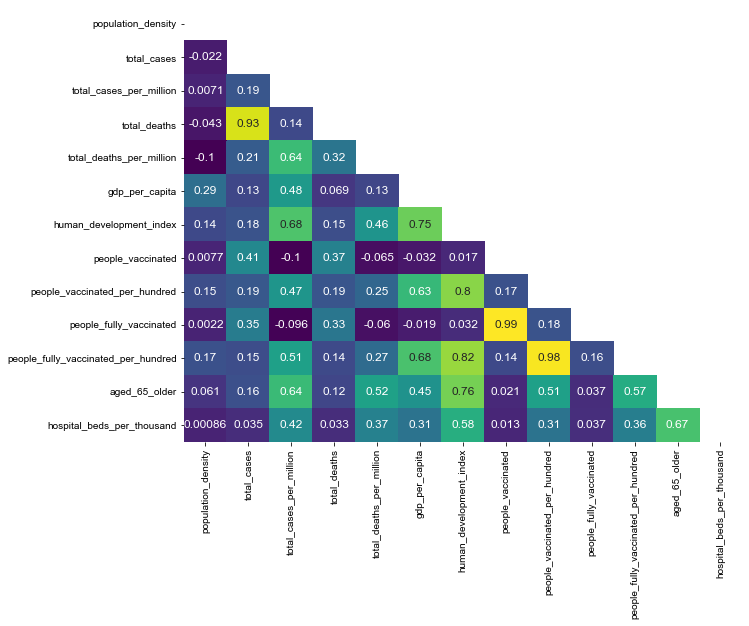

In [23]:
count_corr = country_summary.iloc[:,:15].corr()
mask = np.ones_like(count_corr, dtype = np.bool)
mask = np.triu(mask)

fig, ax = plt.subplots(figsize=(10,8)) 
sns.set(style = 'white')
sns.heatmap(count_corr, annot = True, mask = mask, cmap = 'viridis', cbar = False)

In [24]:
# Just change this section and everything should work
plt_title = 'Map - Stringency Index'
var = 'stringency_index'
var_name = "Cases per million"
color_map = 'viridis'
size = 12
opcty = 1

# Creating the map
val_list = month_end_data[var].values.tolist()
fig = px.density_mapbox(month_end_data, lat = 'Latitude', lon = 'Longitude',
                        hover_name = 'location', z = var, 
                        animation_frame= 'date', animation_group="location",
                        center=dict(lat=0, lon=0), radius = size,
                        range_color = [min(val_list),max(val_list)],
                        zoom = 0, mapbox_style = 'open-street-map',
                        color_continuous_scale = color_map,
                        opacity = opcty)

fig.update_layout(title=plt_title,
                  legend_title= var_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)

fig.show()

In [25]:
# Just change this section and everything should work
plt_title = 'Map - Total cases per million'
var = 'total_cases_per_million'
var_name = "Cases per million"
color_map = 'inferno'
size = 15
opcty = 1

# Creating the map
val_list = month_end_data[var].values.tolist()
fig = px.density_mapbox(month_end_data, lat = 'Latitude', lon = 'Longitude',
                        hover_name = 'location', z = var, 
                        animation_frame= 'date', animation_group="location",
                        center=dict(lat=0, lon=0), radius = size,
                        range_color = [min(val_list),max(val_list)],
                        zoom = 0, mapbox_style = 'open-street-map',
                        color_continuous_scale = color_map,
                        opacity = opcty)

fig.update_layout(title=plt_title,
                  legend_title= var_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)

fig.show()

<font color='cornflowerblue' size = 4>**Continent Analysis**</font>

In [26]:
continent_summary.describe()

,location,total_cases,total_deaths,gdp_per_capita,human_development_index
count,5.000000,5.000000e+00,5.000000e+00,5.000000,5.000000
mean,28.600000,5.927519e+07,1.081988e+06,22165.047554,0.767790
std,14.892951,5.044201e+07,9.912223e+05,11323.648728,0.124411
min,3.000000,8.326320e+05,3.076000e+03,5955.861000,0.574972
25%,28.000000,8.953979e+06,2.119490e+05,16063.264964,0.751342
50%,36.000000,8.467086e+07,1.245686e+06,24652.334974,0.756679
75%,38.000000,9.355086e+07,1.533761e+06,29812.509333,0.872667
max,38.000000,1.083676e+08,2.415469e+06,34341.267500,0.883289


<div style="padding:3px;background-color: orange; color:white;font-size:14px;">Cases & Deaths </div>

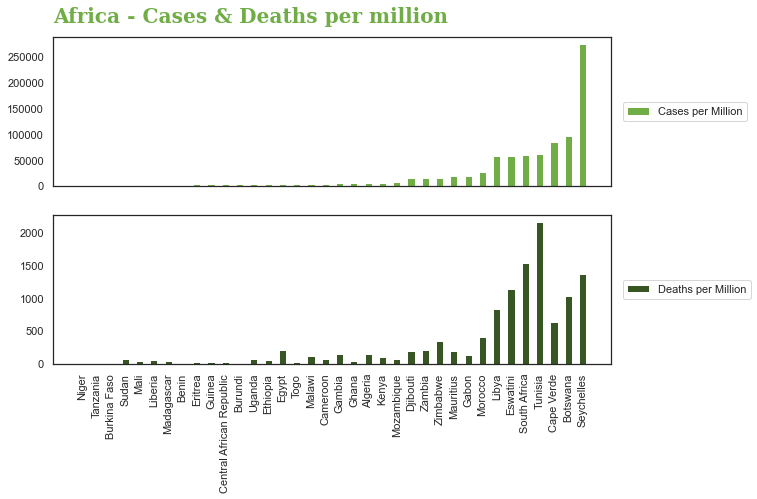

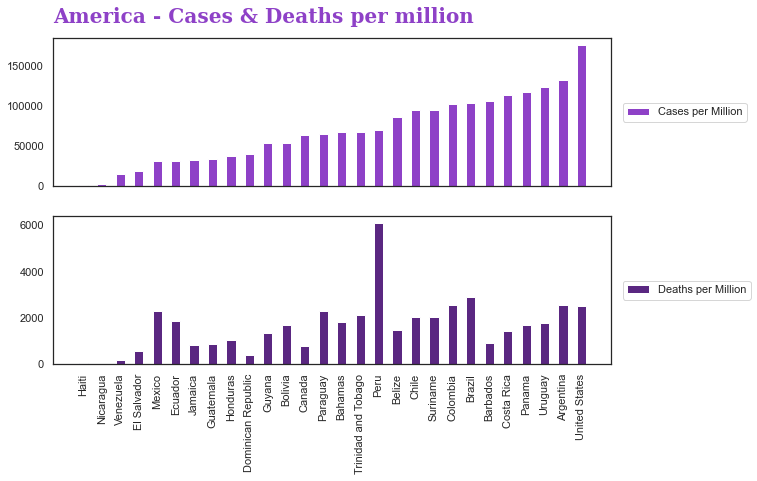

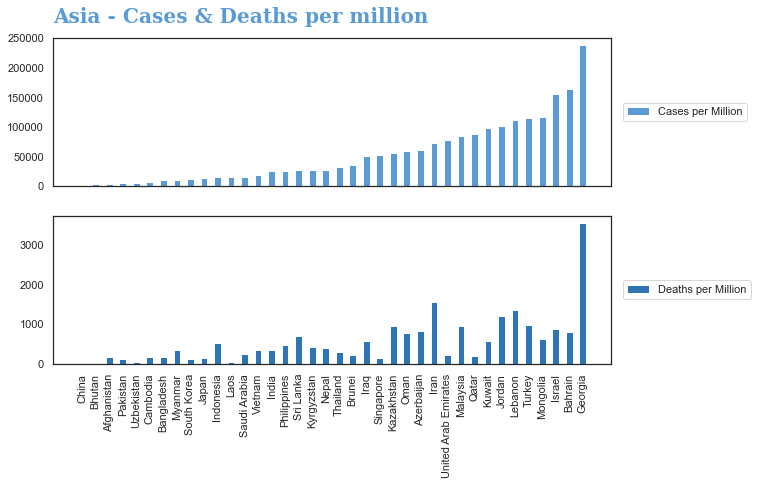

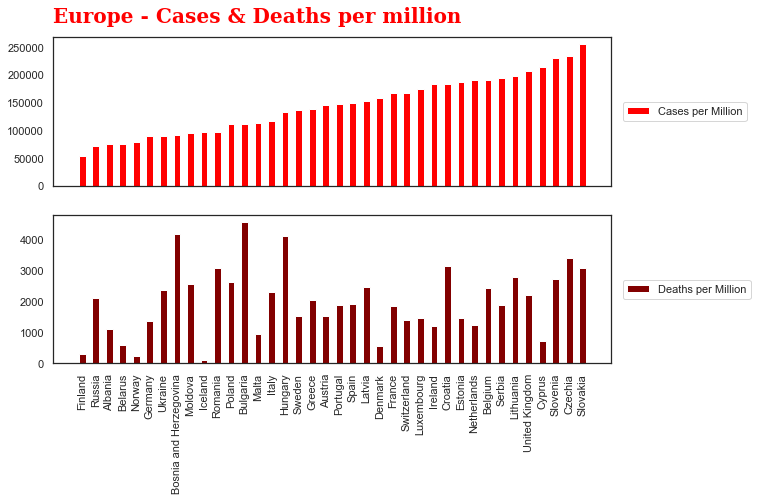

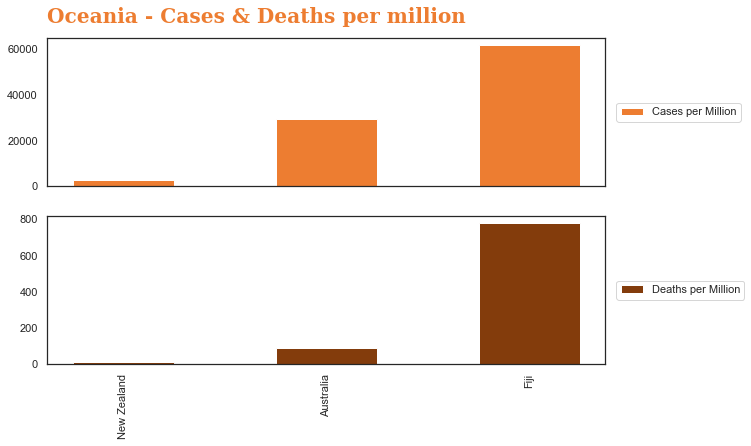

In [27]:
for cont in continents:
    
    # Main and included in main variables
    plt_title = 'Cases & Deaths per million'
    main = 'total_cases_per_million'
    included = 'total_deaths_per_million'
   
    ctry_by_cont = by_continent.get_group(cont)
    ctry_by_cont = ctry_by_cont[ctry_by_cont[main] > 0]
    ctry_by_cont.sort_values(main,inplace = True)
    
    # Creating a barplot for the main variable
    fig, ax = plt.subplots(2,1, figsize = (10,6), sharex = True)
    
    fig.subplots_adjust(hspace = 0.2)
    
    ax[0].bar(ctry_by_cont['location'],
              height = (ctry_by_cont[main]), 
              width = 0.5,
              label = 'Cases per Million',
              color = cont_colors[cont]['mid'])

    ax[1].bar(ctry_by_cont['location'],
              height = (ctry_by_cont[included]), 
              width = 0.5, 
              label = 'Deaths per Million', 
              color = cont_colors[cont]['dark'])
    
    # Formatting
    
    title_font = {'family': 'Serif',
                  'color':  cont_colors[cont]['mid'],
                  'weight': 'heavy',
                  'size': 20,
                 }
    
    ax[0].set_title(label = str(cont) + " - " + plt_title,
                 loc = 'left',
                 fontdict = title_font, 
                 pad = 15)
    
    ax[1].set_xticklabels(ctry_by_cont['location'], rotation = 90)

    ax[0].legend(bbox_to_anchor = (1.01, .5),
                 loc = 'center left')
    
    ax[1].legend(bbox_to_anchor = (1.01, .5),
                 loc = 'center left')

    plt.show()

<div style="padding:3px;background-color: green; color:white;font-size:14px;">Vaccination </div>

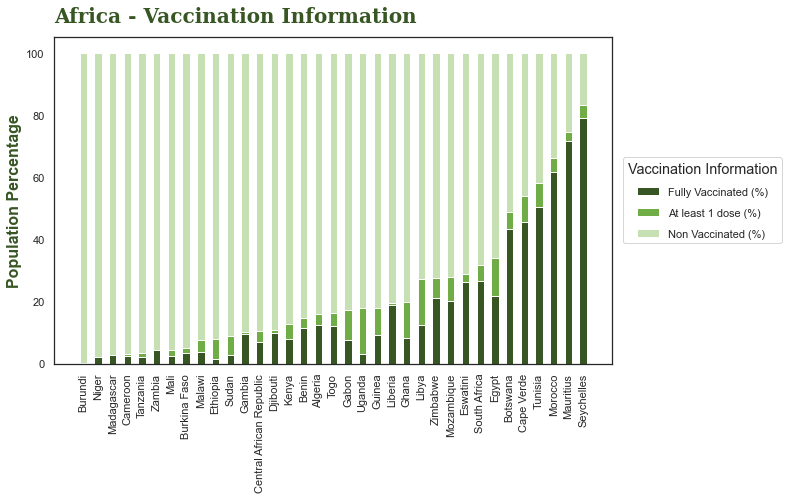

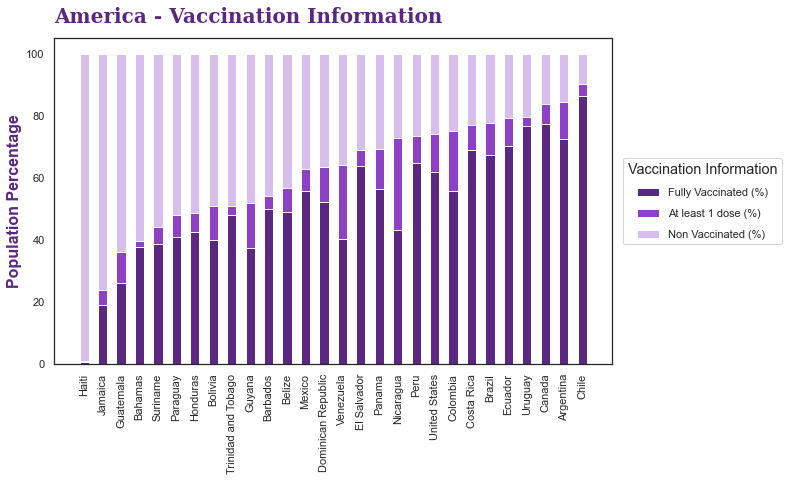

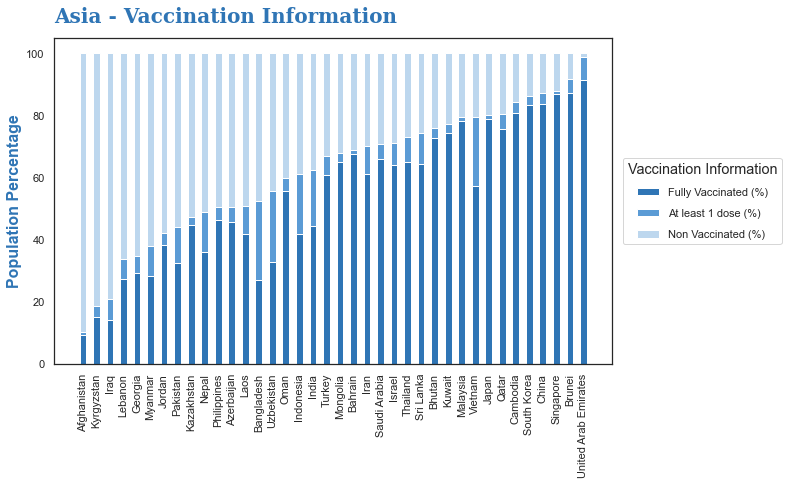

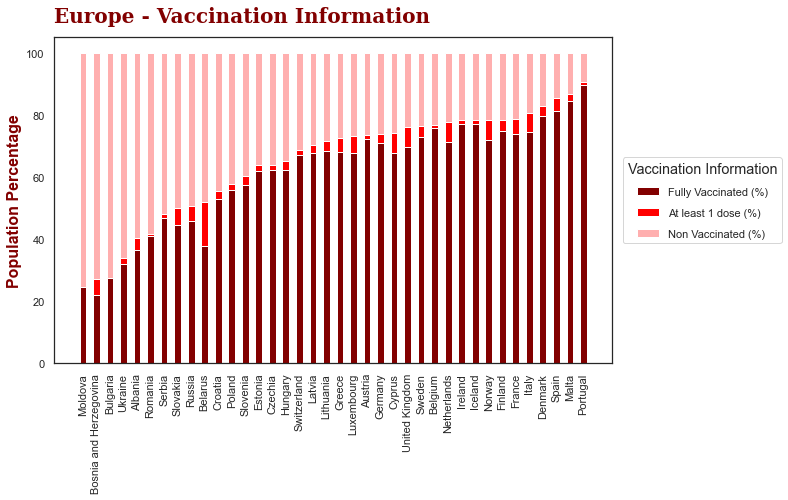

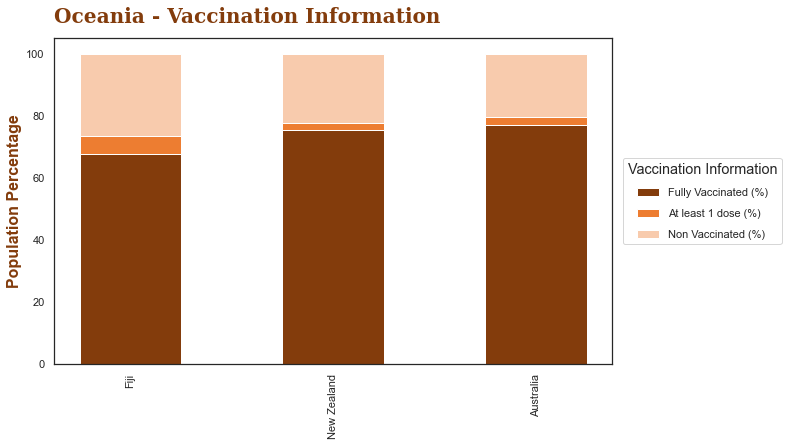

In [28]:
for cont in continents:
    
    # Main and included in main variables
    plt_title = 'Vaccination Information'
    main = 'people_vaccinated_per_hundred'
    included = 'people_fully_vaccinated_per_hundred'
    base = 100
    
    ctry_by_cont = by_continent.get_group(cont)
    ctry_by_cont = ctry_by_cont[ctry_by_cont[main] > 0]
    ctry_by_cont.sort_values(main,inplace = True) ##### Decide if main or included
    
    # Creating a barplot that sums up to 100%
    fig, ax = plt.subplots(1,1, figsize = (10,6), sharex = True)

    # included variable on bottom
    ax.bar(ctry_by_cont['location'],
           height = (ctry_by_cont[included]), 
           width = 0.5, 
           label = 'Fully Vaccinated (%)', 
           color = cont_colors[cont]['dark'])
    
    # main variable above
    ax.bar(ctry_by_cont['location'],
           height = (ctry_by_cont[main] - ctry_by_cont[included]), 
           bottom = ctry_by_cont[included], 
           width = 0.5, 
           label = 'At least 1 dose (%)', 
           color = cont_colors[cont]['mid'])

    # remaining on top
    ax.bar(ctry_by_cont['location'], 
           height = (base - (ctry_by_cont[main])), 
           bottom = (ctry_by_cont[main]), 
           width = 0.5, 
           label = 'Non Vaccinated (%)', 
           color = cont_colors[cont]['pale'])
    
    # Formatting
    
    title_font = {'family': 'Serif',
                  'color':  cont_colors[cont]['dark'],
                  'weight': 'heavy',
                  'size': 20,
                 }
    label_font = {'family': 'Arial',
                  'color':  cont_colors[cont]['dark'],
                  'weight': 'bold',
                  'size': 16,
                 }
    
    ax.set_title(label = str(cont) + " - " + plt_title,
                 loc = 'left',
                 fontdict = title_font, 
                 pad = 15)
    ax.set_xticklabels(ctry_by_cont['location'], rotation = 90)
    ax.set_ylabel('Population Percentage',
                  fontdict = label_font)
    
    ax.legend(title = plt_title,
              title_fontsize = 'large',
              bbox_to_anchor = (1.01, .5),
              labelspacing = 1,
              loc = 'center left')

    plt.show()

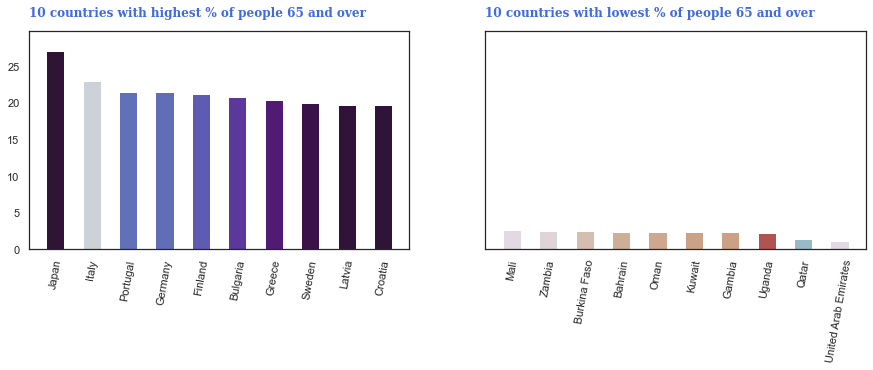

In [29]:
var = 'aged_65_older'
plt_title = '% of people 65 and over'
qty = 10
max_lim = country_summary[var].max() * 1.1

top_countries = country_summary.sort_values(by = 'aged_65_older', ascending = False).head(qty)
last_countries = country_summary.sort_values(by = 'aged_65_older', ascending = False).tail(qty)
all_countries = pd.concat([top_countries, last_countries])

# Creating a barplot for the main variable
fig, ax = plt.subplots(1,2, figsize = (15,4), sharey = True)

fig.subplots_adjust(hspace = 0.2)

rescale = lambda y: (y - np.min(y)) / (np.max(y) - np.min(y))
top_cmap = plt.get_cmap("twilight_shifted")
low_cmap = plt.get_cmap("twilight")

ax[0].bar(top_countries['location'],
          height = top_countries[var],
          width = 0.5,
          color = top_cmap(rescale(top_countries[var])))

ax[1].bar(last_countries['location'],
          height = last_countries[var],
          width = 0.5,
          color = low_cmap(rescale(last_countries[var])))

# Formatting

title_font = {'family': 'Serif',
              'color':  'royalblue',
              'weight': 'heavy',
              'size': 12,
             }

ax[0].set_title(label = str(qty) + " countries with highest " + plt_title,
                loc = 'left',
                fontdict = title_font, 
                pad = 15)

ax[1].set_title(label = str(qty) + " countries with lowest " + plt_title,
                loc = 'left',
                fontdict = title_font, 
                pad = 15)

ax[0].set_ylim(0,max_lim) # Setting limits
ax[1].set_ylim(0,max_lim) # Setting limits

ax[0].set_xticklabels(top_countries['location'], rotation = 80)
ax[1].set_xticklabels(last_countries['location'], rotation = 80)

plt.show()

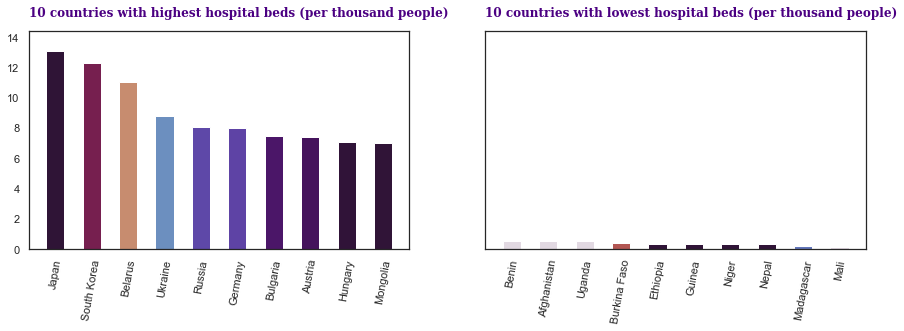

In [30]:
var = 'hospital_beds_per_thousand'
plt_title = 'hospital beds (per thousand people)'
qty = 10
max_lim = country_summary[var].max() * 1.1

top_countries = country_summary.sort_values(by = var, ascending = False).head(qty)
last_countries = country_summary.sort_values(by = var, ascending = False).tail(qty)
all_countries = pd.concat([top_countries, last_countries])

# Creating a barplot for the main variable
fig, ax = plt.subplots(1,2, figsize = (15,4), sharey = True)

fig.subplots_adjust(hspace = 0.2)

rescale = lambda y: (y - np.min(y)) / (np.max(y) - np.min(y))
top_cmap = plt.get_cmap("twilight_shifted")
low_cmap = plt.get_cmap("twilight")

ax[0].bar(top_countries['location'],
          height = top_countries[var],
          width = 0.5,
          color = top_cmap(rescale(top_countries[var])))

ax[1].bar(last_countries['location'],
          height = last_countries[var],
          width = 0.5,
          color = low_cmap(rescale(last_countries[var])))

# Formatting

title_font = {'family': 'Serif',
              'color':  'indigo',
              'weight': 'heavy',
              'size': 12,
             }

ax[0].set_title(label = str(qty) + " countries with highest " + plt_title,
                loc = 'left',
                fontdict = title_font, 
                pad = 15)

ax[1].set_title(label = str(qty) + " countries with lowest " + plt_title,
                loc = 'left',
                fontdict = title_font, 
                pad = 15)

ax[0].set_ylim(0,max_lim) # Setting limits
ax[1].set_ylim(0,max_lim) # Setting limits

ax[0].set_xticklabels(top_countries['location'], rotation = 80)
ax[1].set_xticklabels(last_countries['location'], rotation = 80)

plt.show()

In [31]:
# Change these to see different graphs
plt_title = 'HDI VS People Vaccinated (%)'
var_x = 'people_vaccinated_per_hundred'
x_name = 'People Vaccinated per Hundred'
var_y = 'human_development_index'
y_name = 'Human Development Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly_dark'

# Automatic limits. You can change this manually
max_x = 100
max_y = month_end_data[var_y].max() * 1.1

# Constructing the graph
fig = px.scatter(month_end_data_2021, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

In [32]:
# Change these to see different graphs
plt_title = 'HDI VS People Fully Vaccinated (%)'
var_x = 'people_fully_vaccinated_per_hundred'
x_name = 'People Fully Vaccinated per Hundred'
var_y = 'human_development_index'
y_name = 'Human Development Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly_dark'

# Automatic limits. You can change this manually
max_x = 100
max_y = month_end_data[var_y].max() * 1.1

# Constructing the graph
fig = px.scatter(month_end_data_2021, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

In [33]:
# Change these to see different graphs
plt_title = 'Cases VS Deaths (per million)'
var_x = 'total_cases_per_million'
x_name = 'Total cases per million'
var_y = 'total_deaths_per_million'
y_name = 'Total deaths per million'
group = 'continent'
group_name = 'Continent'
theme = 'plotly_dark'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = month_end_data[var_y].max() * 1.1

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

In [34]:
# Change these to see different graphs
plt_title = 'HDI VS Cases per million'
var_x = 'total_cases_per_million'
x_name = 'Total cases per million'
var_y = 'human_development_index'
y_name = 'Human Development Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly_dark'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = month_end_data[var_y].max() * 1.1

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

<div style="padding:10px;background-color: cornflowerblue; color:white;font-size:24px;">Stringency Analysis by Continent</div>

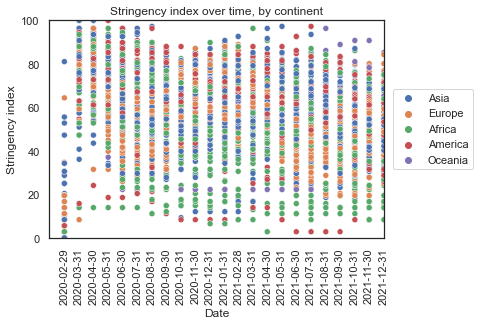

In [35]:
# Stringency over time, all countries
subset = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021))]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', hue='continent', data=subset)
plt.ylabel('Stringency index')
plt.xlabel('Date')

#the pd.to_datetime works because we parsed date column as dates
ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, by continent'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

Text(0.5, 1.0, 'Stringency index over time, Africa')

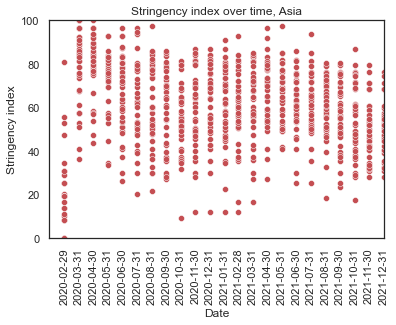

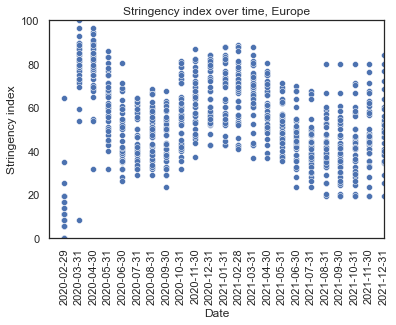

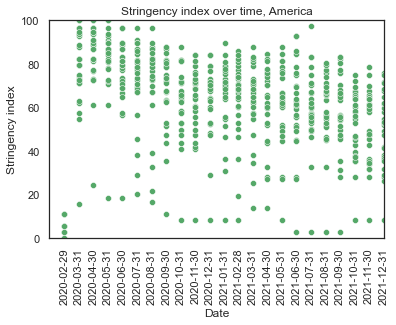

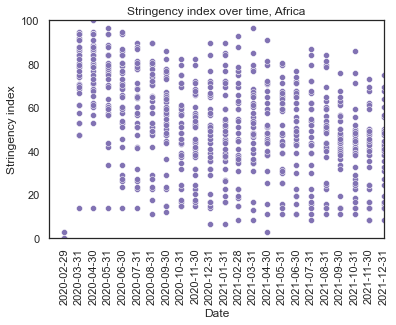

In [36]:
# time on x-axis, stringency on y-axis, see by continent

# Asia
subsetAsia = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['continent']=='Asia')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetAsia, color = 'r')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, Asia'
plt.title(title)

# Europe
subsetEuro = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['continent']=='Europe')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetEuro, color = 'b')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, Europe'
plt.title(title)

# North America
subsetNA = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['continent']=='America')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetNA, color = 'g')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, America'
plt.title(title)

# Africa
subsetAfrica = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['continent']=='Africa')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetAfrica, color = 'm')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, Africa'
plt.title(title)

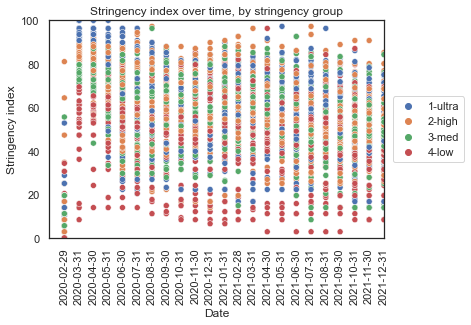

In [37]:
# Look at stringency overtime by stringency group
subset = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021))]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', hue='str_grp', data=subset)
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, by stringency group'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

Text(0.5, 1.0, 'Stringency index over time, low stringency')

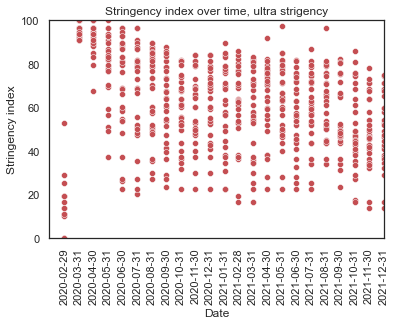

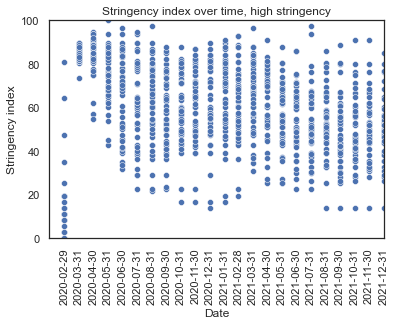

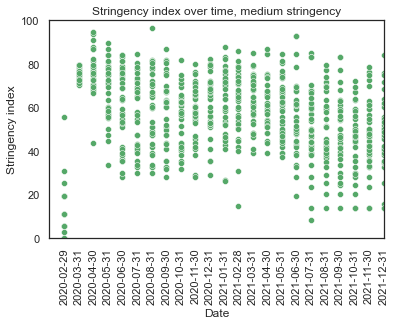

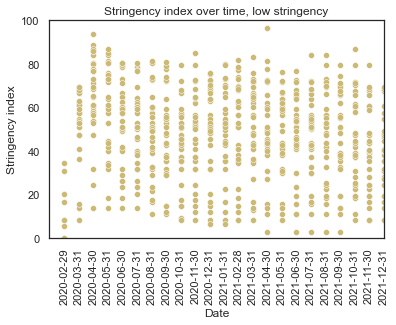

In [38]:
# time on x-axis, stringency on y-axis, see by stringency group

# Ultra
subsetUltra = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['str_grp']=='1-ultra')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetUltra, color = 'r')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, ultra strigency'
plt.title(title)

# High
subsetHigh = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['str_grp']=='2-high')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetHigh, color = 'b')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, high stringency'
plt.title(title)

# Med
subsetMed = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['str_grp']=='3-med')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetMed, color = 'g')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, medium stringency'
plt.title(title)

# Low
subsetLow = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['str_grp']=='4-low')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetLow, color = 'y')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, low stringency'
plt.title(title)

In [39]:
# Change these to see different graphs
plt_title = 'Stringency VS Population Density'
var_x = 'population_density'
x_name = 'Population Density (Log)'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=True, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

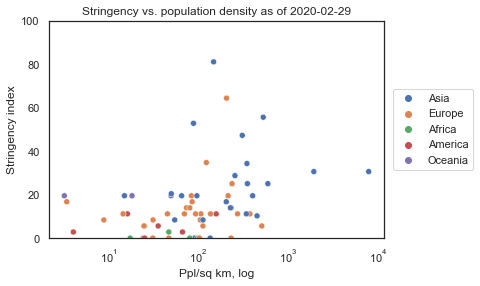

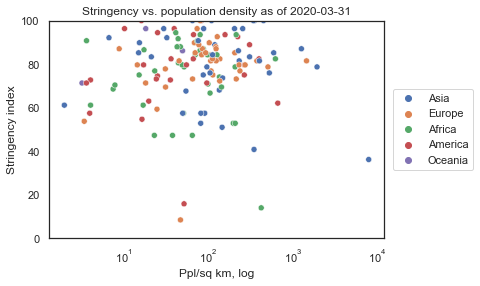

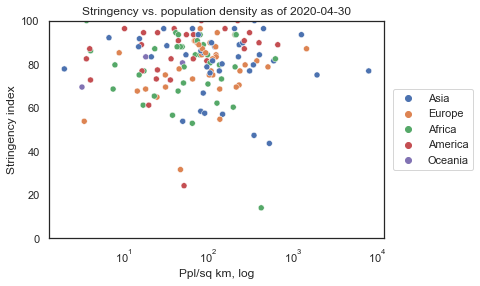

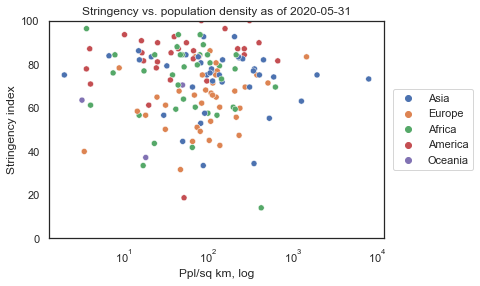

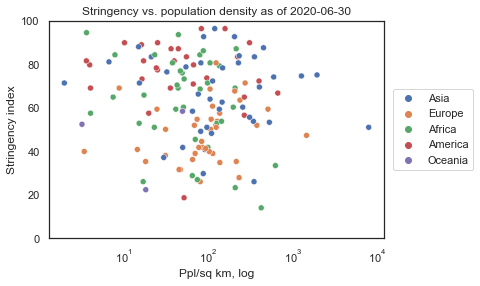

...

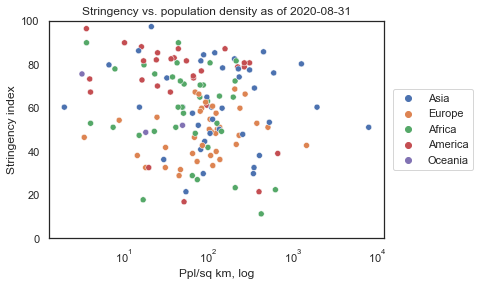

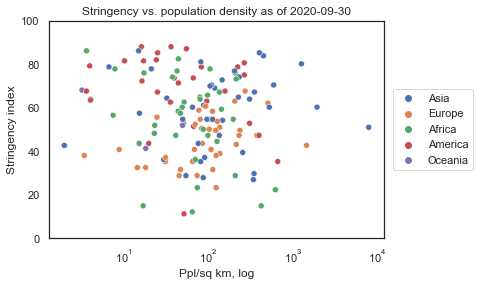

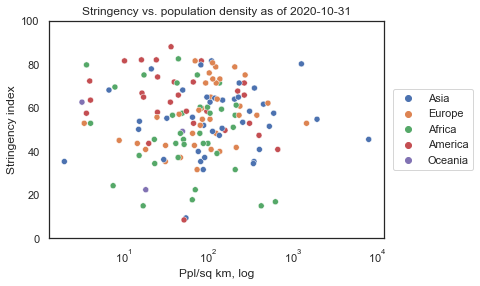

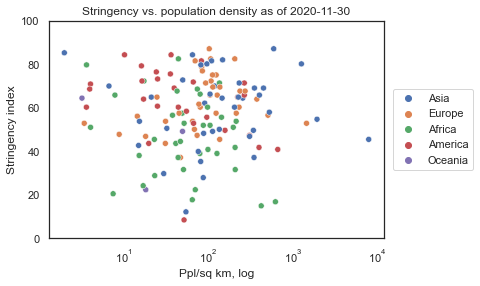

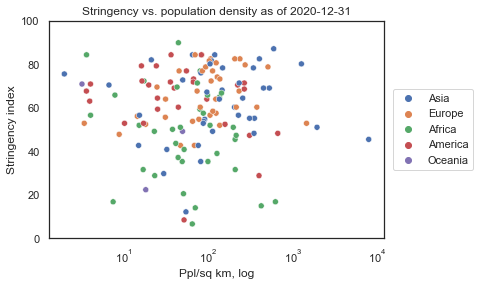

In [40]:
# 2020 population density vs stringency, color by continent
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='population_density', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Ppl/sq km, log')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. population density as of '+date
    plt.title(title)
    ax.set_ylim(0,100)
    plt.xscale('log')
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

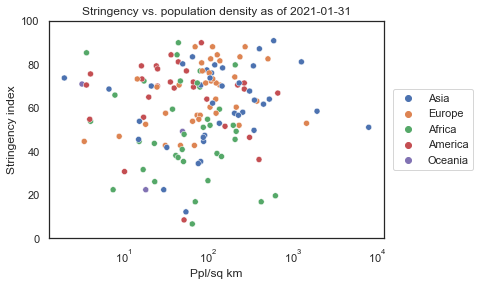

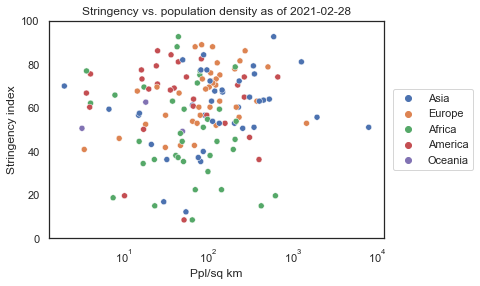

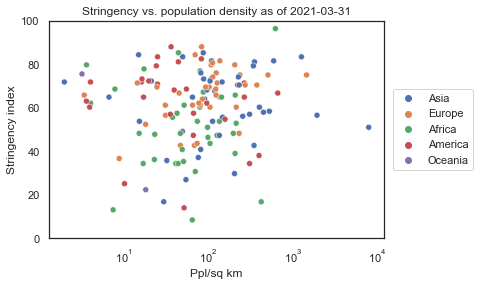

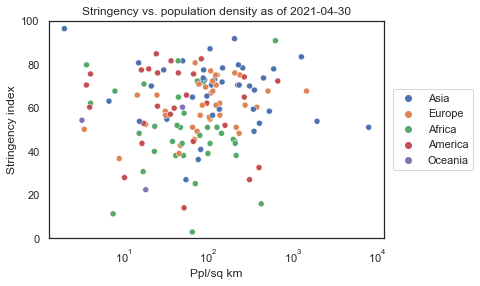

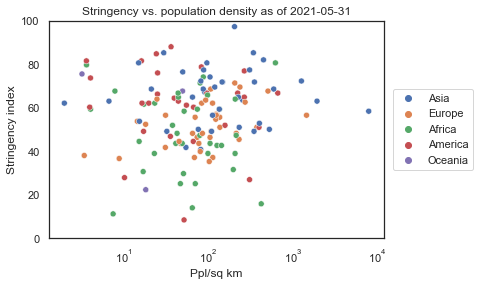

...

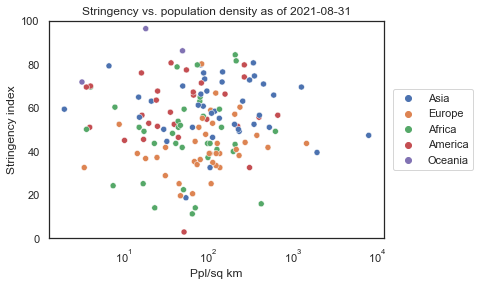

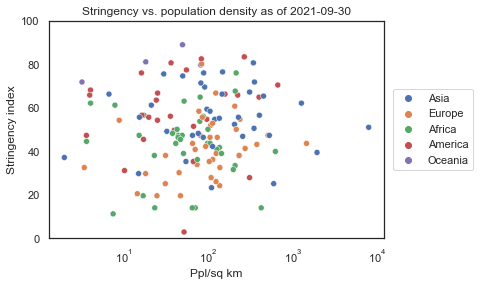

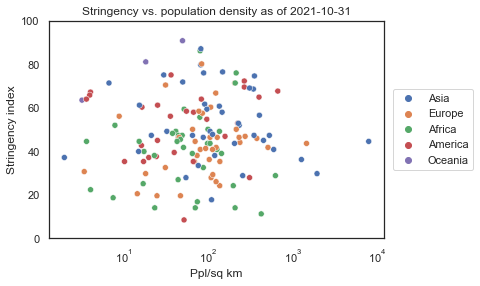

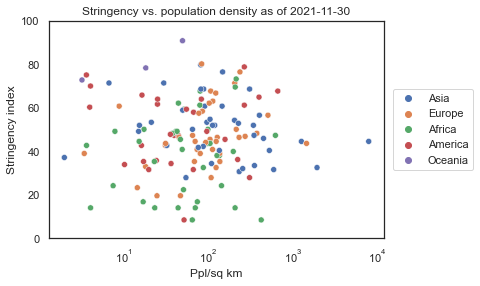

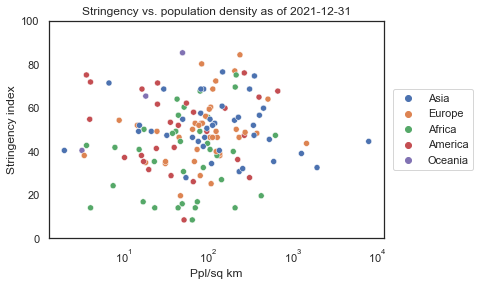

In [41]:
# 2021 population density vs stringency, color by continent
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='population_density', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Ppl/sq km')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. population density as of '+date
    plt.title(title)
    ax.set_ylim(0,100)
    plt.xscale('log')
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [42]:
# Change these to see different graphs
plt_title = 'Stringency VS New Cases (per million)'
var_x = 'total_cases_per_million'
x_name = 'New Cases per Million'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = month_end_data[var_y].max() * 1.1

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

In [43]:
# Change these to see different graphs
plt_title = 'Stringency VS HDI'
var_x = 'human_development_index'
x_name = 'Human Development Index'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

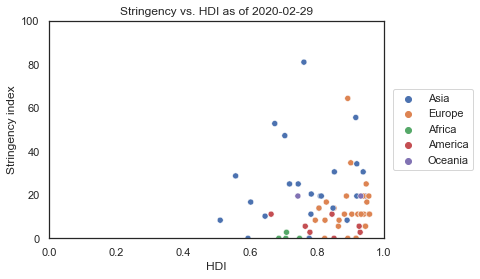

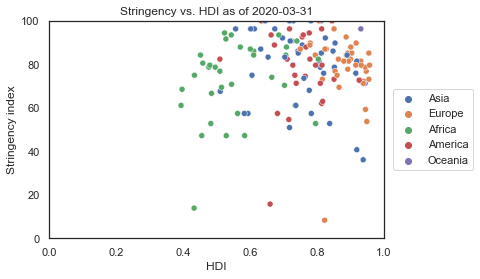

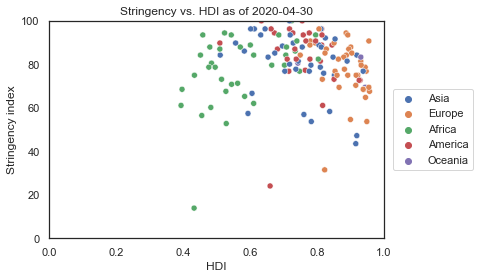

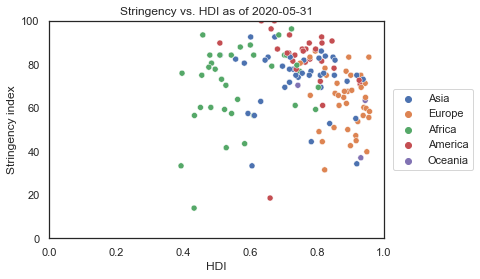

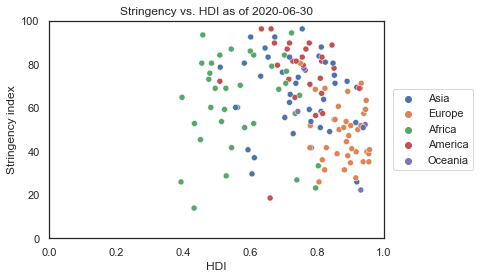

...

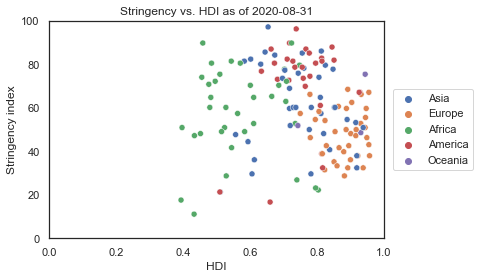

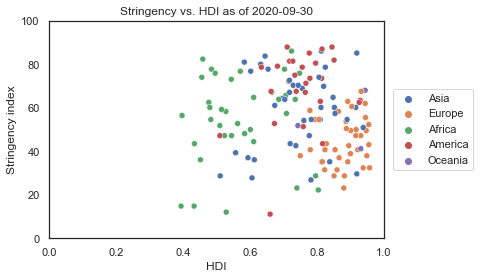

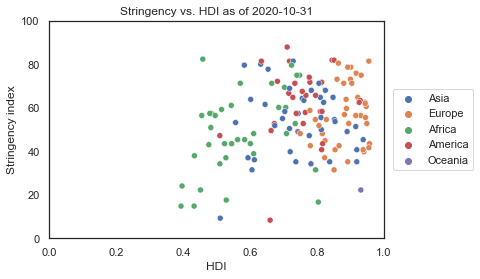

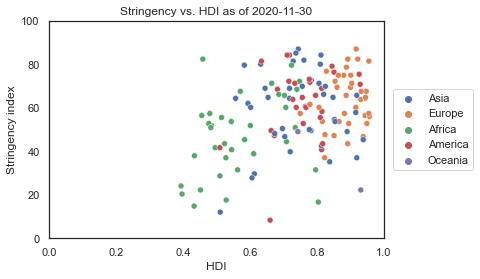

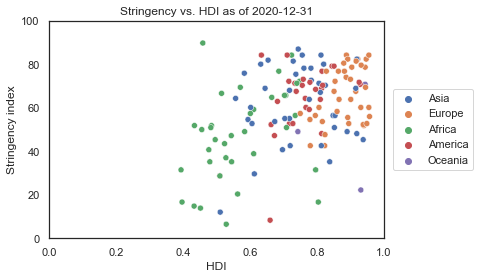

In [44]:
# 2020 HDI vs stringency
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='human_development_index', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('HDI')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. HDI as of '+date
    plt.title(title)
    plt.ylim(0,100)
    plt.xlim(0,1)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

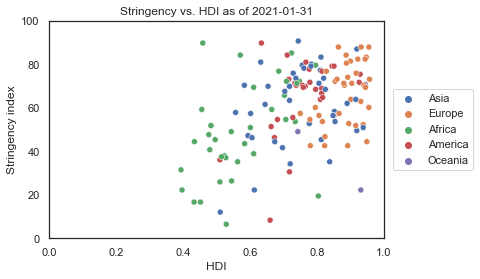

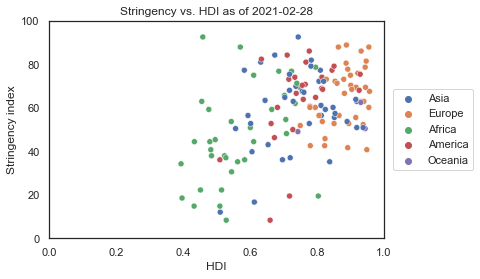

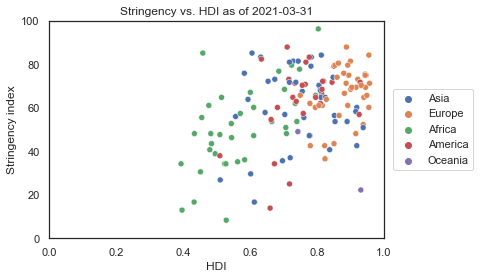

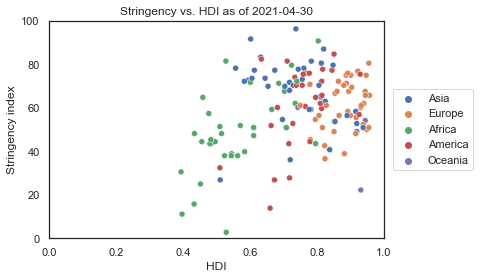

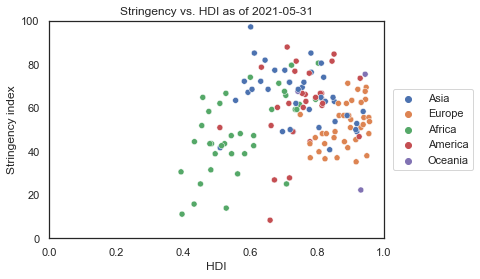

...

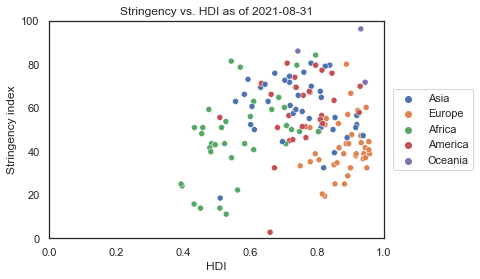

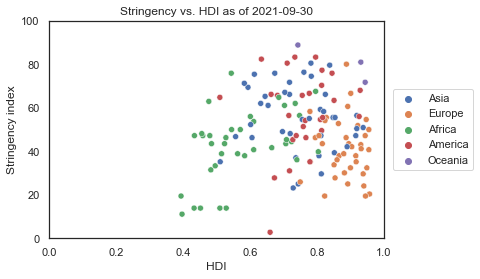

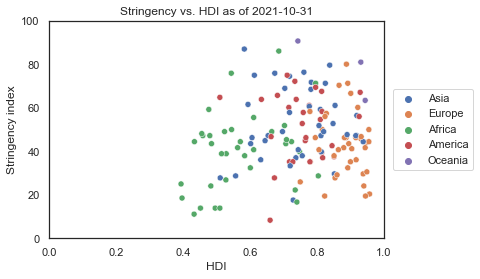

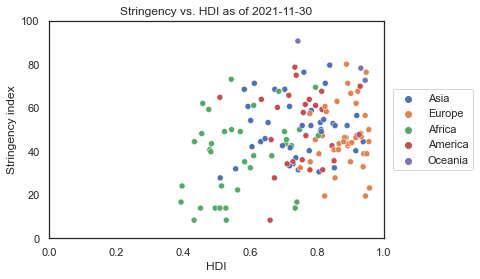

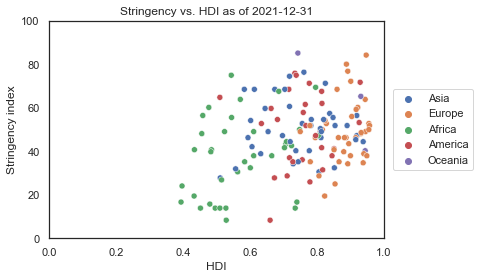

In [45]:
# 2021 HDI vs stringency
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='human_development_index', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('HDI')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. HDI as of '+date
    plt.title(title)
    plt.xlim(0,1)
    plt.ylim(0,100)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [46]:
# Change these to see different graphs
plt_title = 'Stringency VS Positive Rate'
var_x = 'positive_rate'
x_name = 'Positive Rate'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

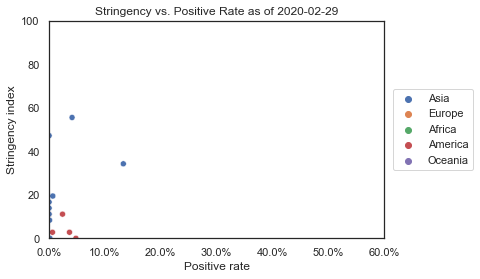

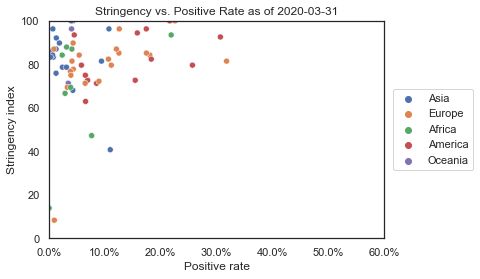

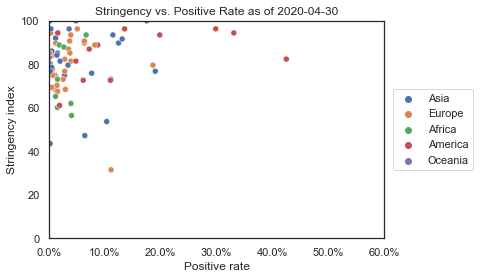

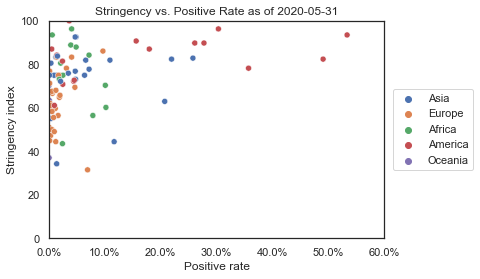

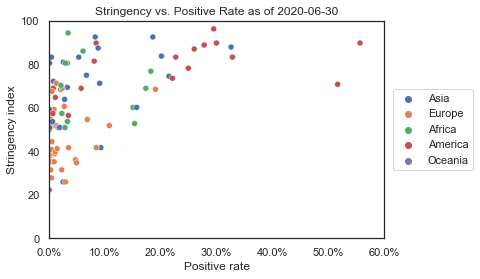

...

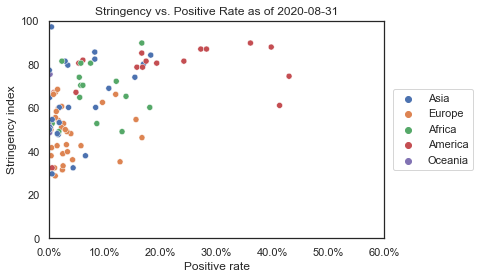

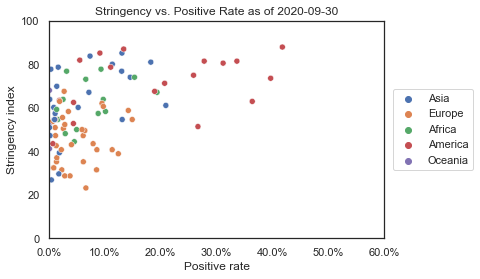

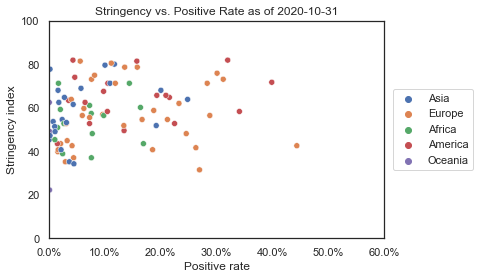

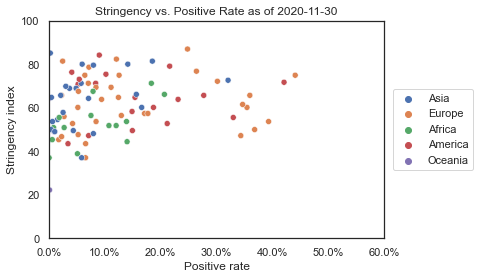

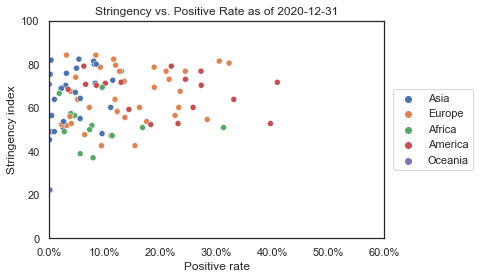

In [47]:
# Positive test exploration
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='positive_rate', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Positive rate')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. Positive Rate as of '+date
    plt.title(title)
    plt.xlim(0,0.6)
    plt.ylim(0, 100)
    ax.xaxis.set_major_formatter(mtick.StrMethodFormatter('{x:.1%}'))
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

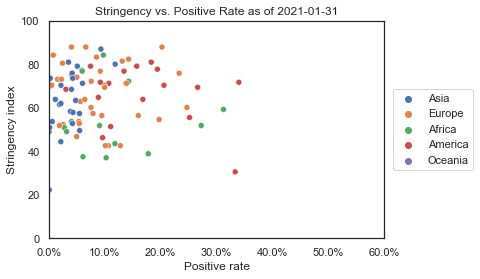

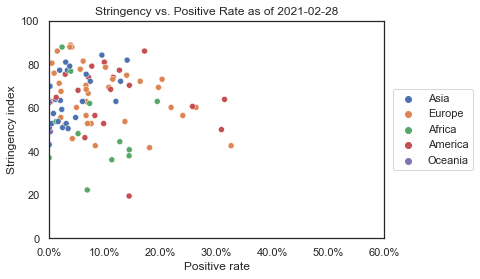

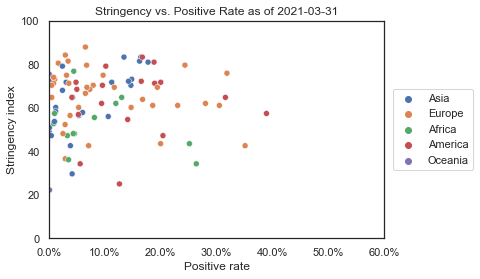

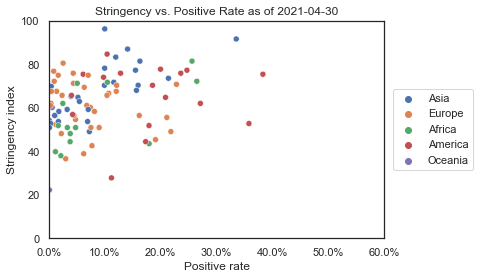

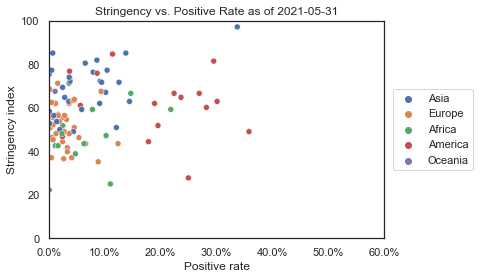

...

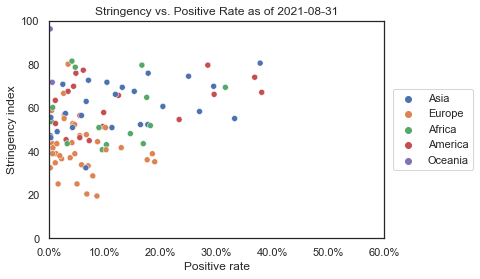

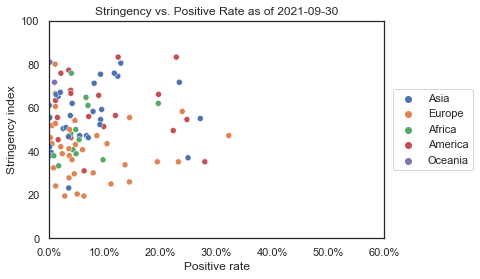

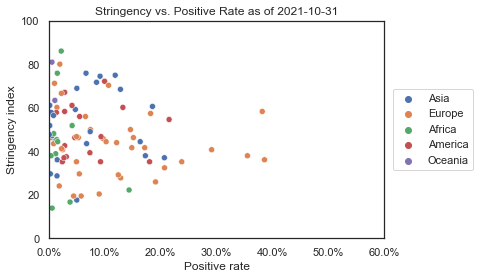

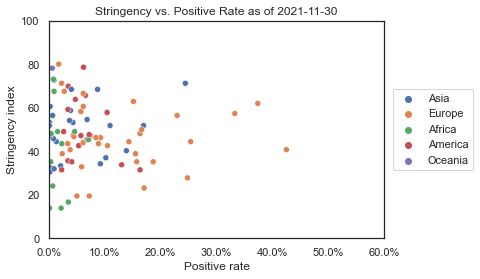

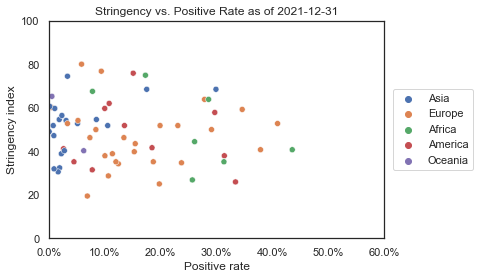

In [48]:
# 2021 positive rate, by continent
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='positive_rate', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Positive rate')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. Positive Rate as of '+date
    plt.title(title)
    plt.xlim(0,0.6)
    plt.ylim(0, 100)
    ax.xaxis.set_major_formatter(mtick.StrMethodFormatter('{x:.1%}'))
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [49]:
# Change these to see different graphs
plt_title = 'Stringency VS People Vaccinated (2021)'
var_x = 'people_vaccinated_per_hundred'
x_name = 'People Vaccinated (per hundred) - At least one dose'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'

# Automatic limits. You can change this manually
max_x = 100
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data_2021, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

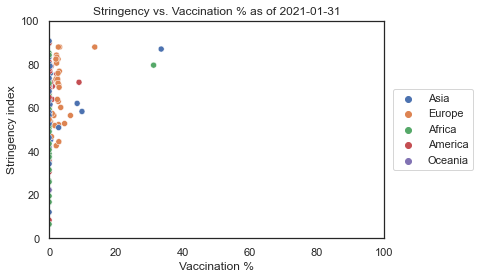

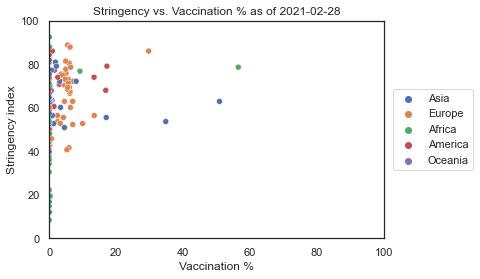

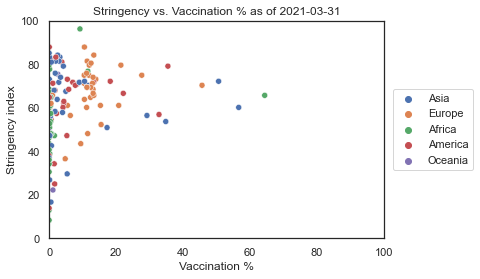

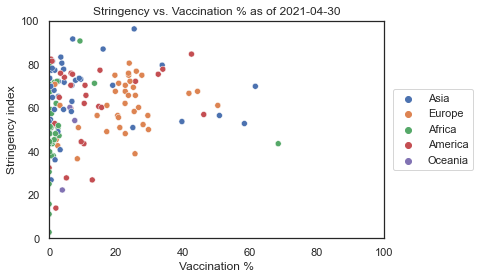

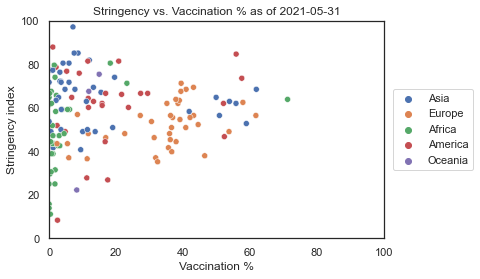

...

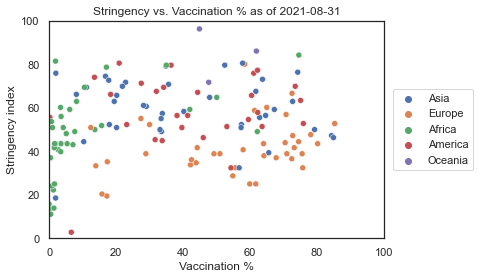

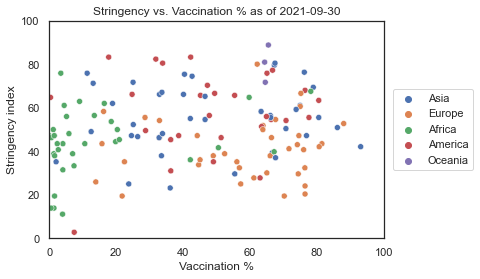

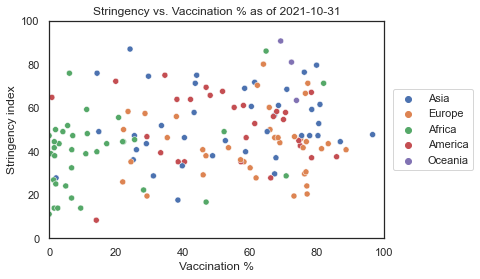

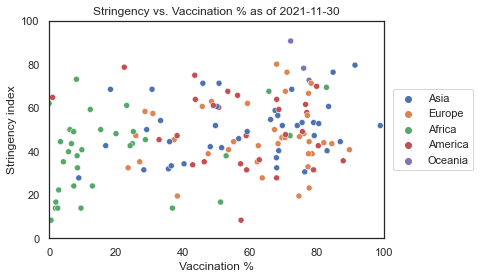

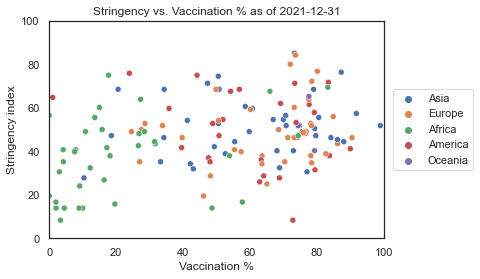

In [50]:
# Vaccination over time vs stringency
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='people_vaccinated_per_hundred', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Vaccination %')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. Vaccination % as of '+date
    plt.xlim(0,100)
    plt.ylim(0,100)
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [51]:
# Change these to see different graphs
plt_title = 'Stringency VS Fully Vaccinated (2021)'
var_x = 'people_fully_vaccinated_per_hundred'
x_name = 'People Fully Vaccinated (per hundred)'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'

# Automatic limits. You can change this manually
max_x = 100
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data_2021, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

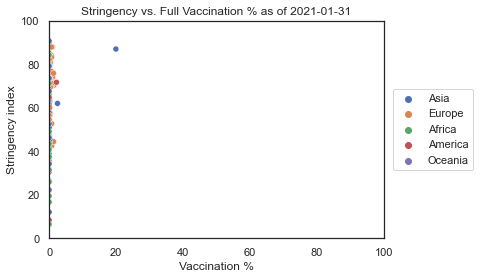

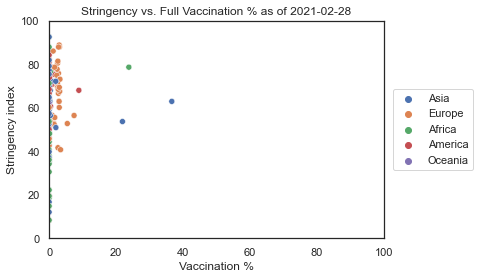

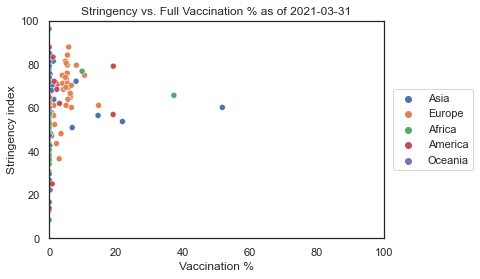

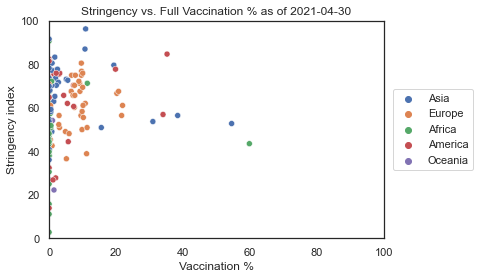

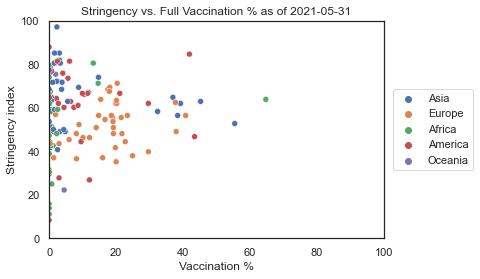

...

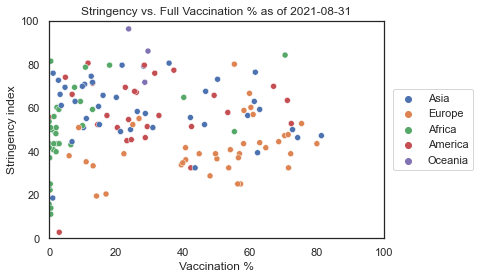

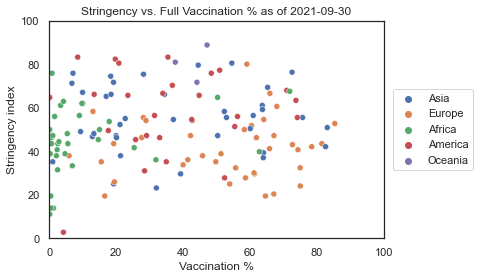

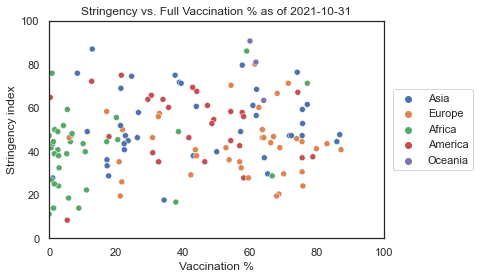

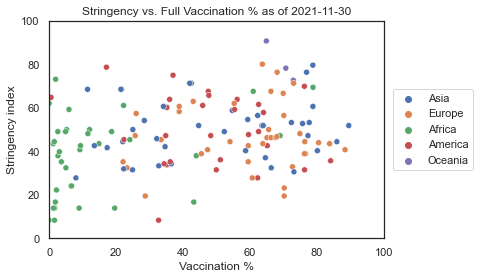

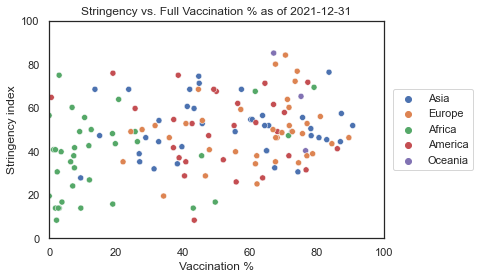

In [52]:
# Full vaccination over time in 2021
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='people_fully_vaccinated_per_hundred', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Vaccination %')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. Full Vaccination % as of '+date
    plt.xlim(0,100)
    plt.ylim(0,100)
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [53]:
# Change these to see different graphs
plt_title = 'Stringency VS People Vaccinated (%)'
var_x = 'people_vaccinated_per_hundred'
x_name = 'People Vaccinated (%)'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'
division = 'str_grp'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme, facet_col=division,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 9),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

In [54]:
# Change these to see different graphs
plt_title = 'Stringency VS % of Population Aged 65 and Older'
var_x = 'aged_65_older'
x_name = 'Aged 65 and Older (per hundred)'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'continent'
group_name = 'Continent'
theme = 'plotly'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

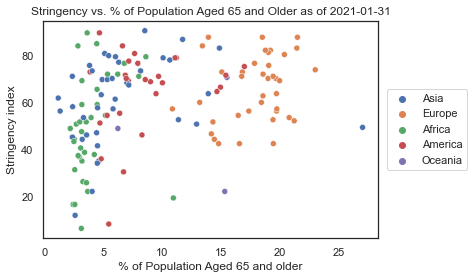

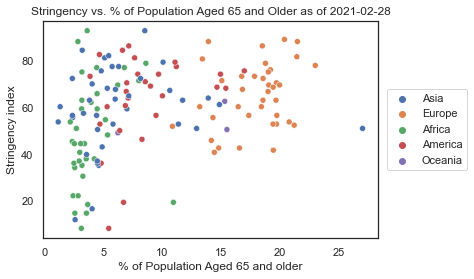

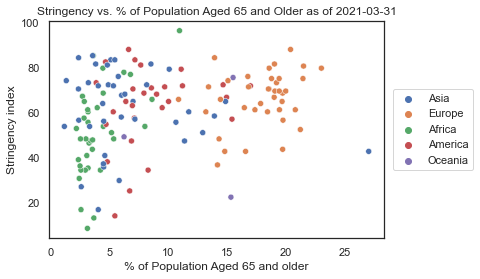

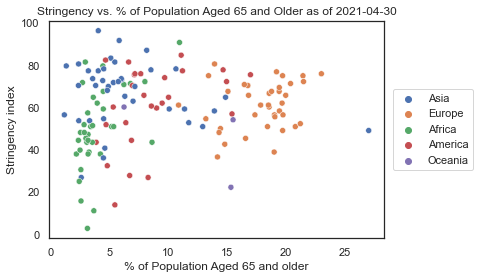

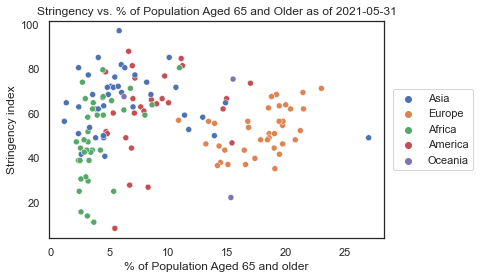

...

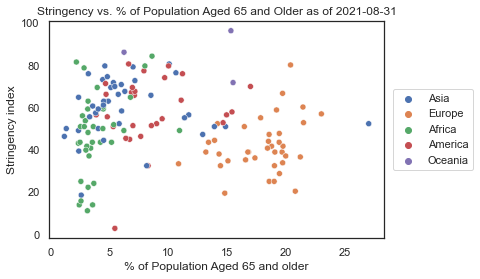

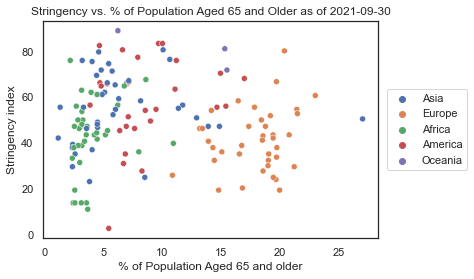

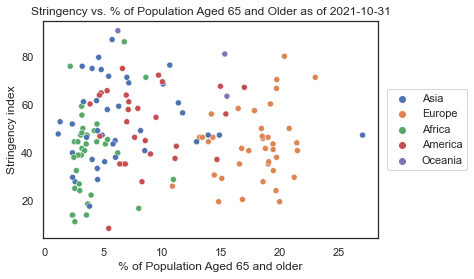

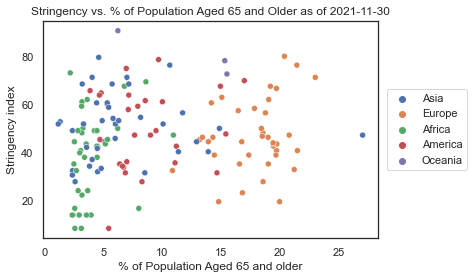

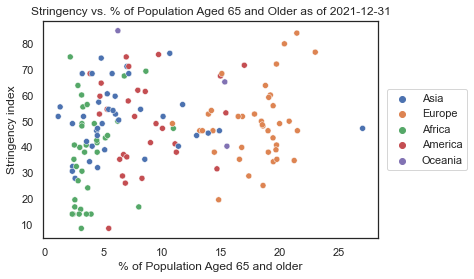

In [55]:
# 2021 Population Aged 65 and older vs stringency, color by continent
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='aged_65_older', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('% of Population Aged 65 and older')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. % of Population Aged 65 and Older as of '+date
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

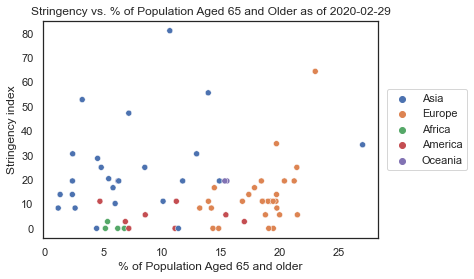

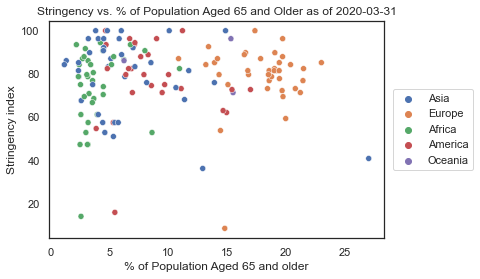

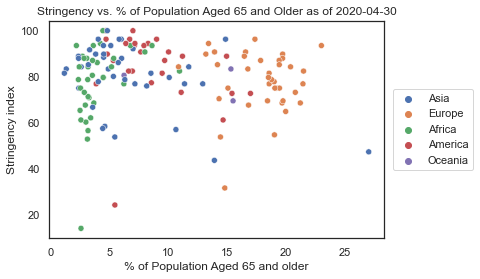

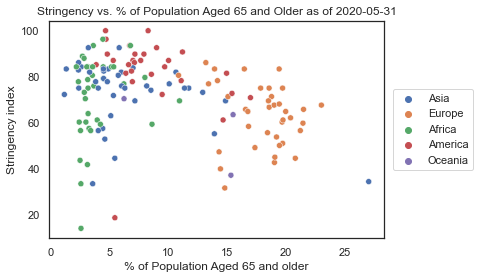

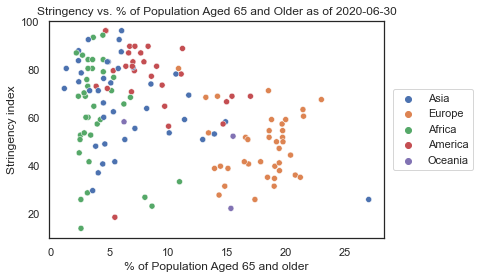

...

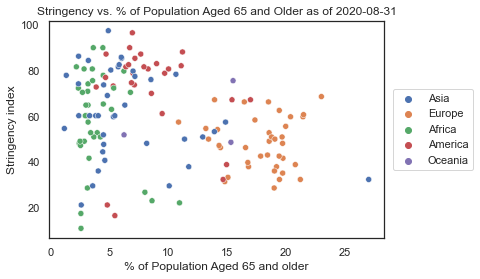

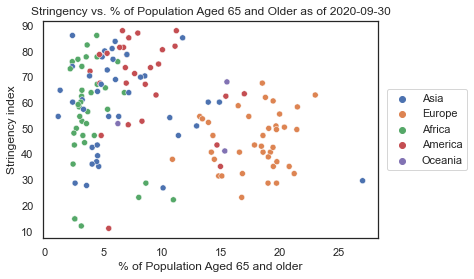

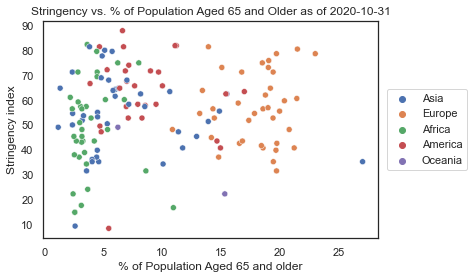

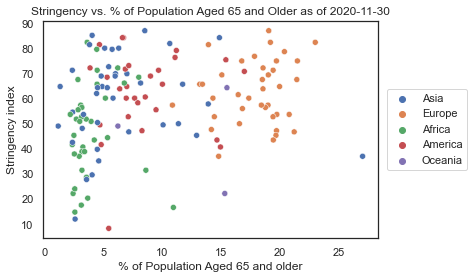

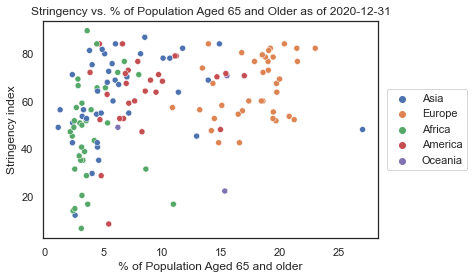

In [56]:
# 2020 Population Aged 65 and older vs stringency, color by continent
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='aged_65_older', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('% of Population Aged 65 and older')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. % of Population Aged 65 and Older as of '+date
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

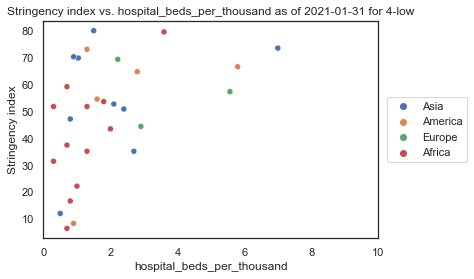

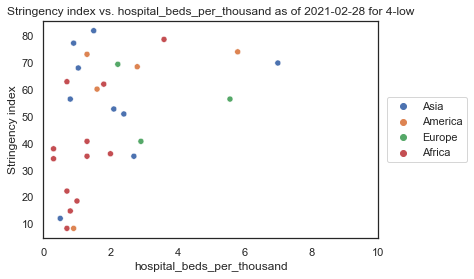

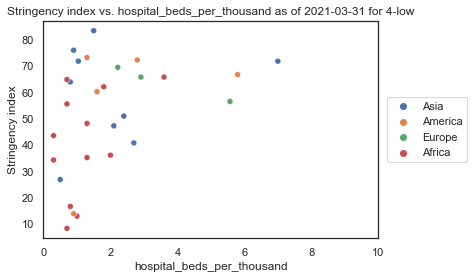

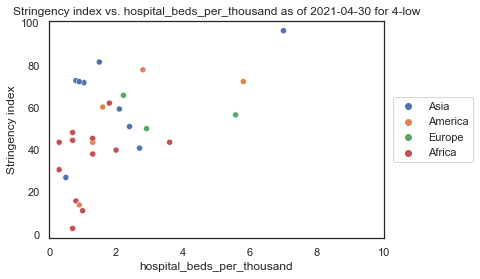

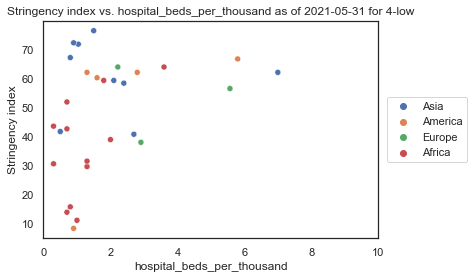

...

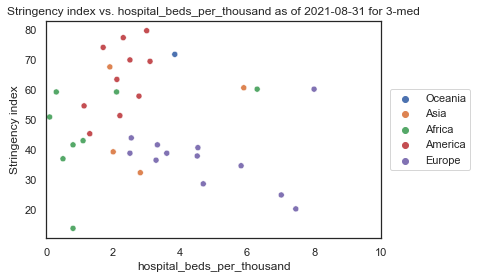

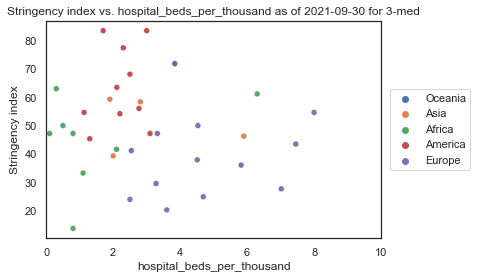

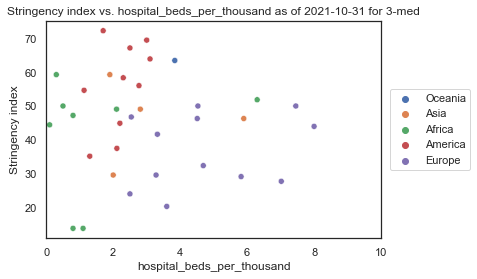

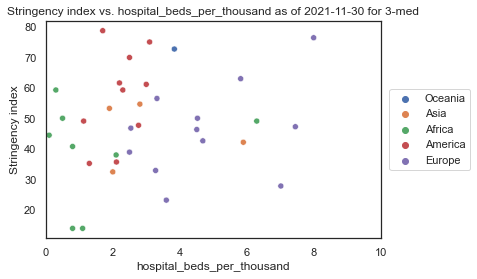

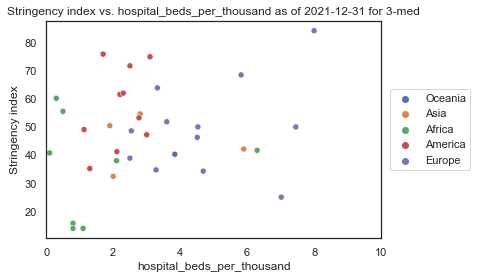

In [57]:
for grp in str_grp_list:
    for date in  month_ends_2021:
        subset = clean_data[(clean_data['str_grp']==grp) & (clean_data['date']==date)]
        fig, ax = plt.subplots(1,1)
        sns.scatterplot(x='hospital_beds_per_thousand', y='stringency_index', hue='continent', data=subset)
        plt.xlabel('hospital_beds_per_thousand')
        plt.ylabel('Stringency index')
        title = 'Stringency index vs. hospital_beds_per_thousand as of '+ date + ' for ' + grp
        plt.xlim(0,10)
        plt.title(title)
        plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

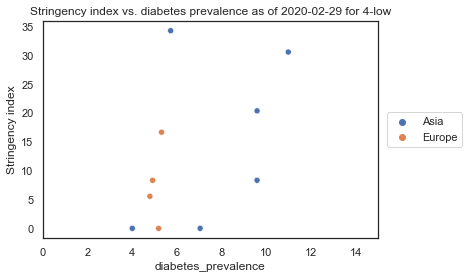

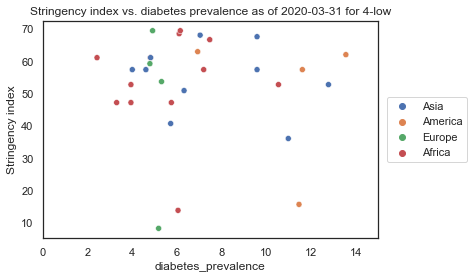

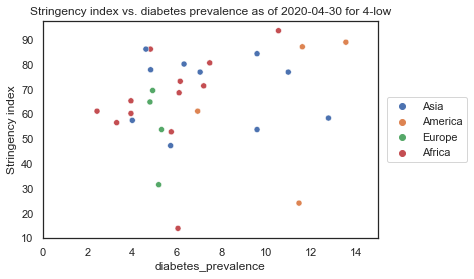

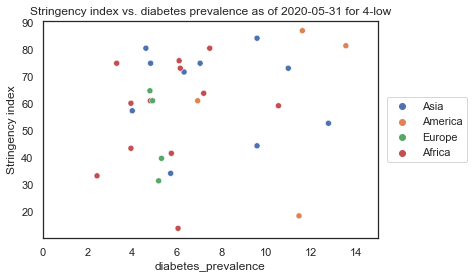

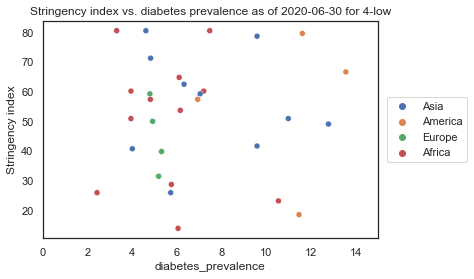

...

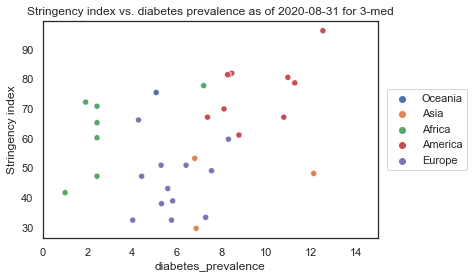

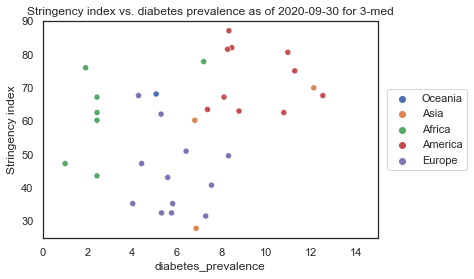

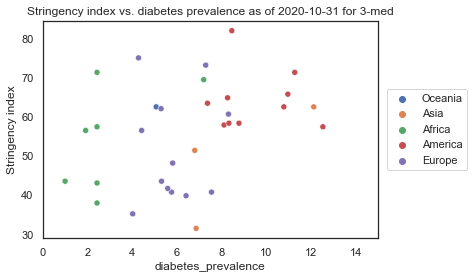

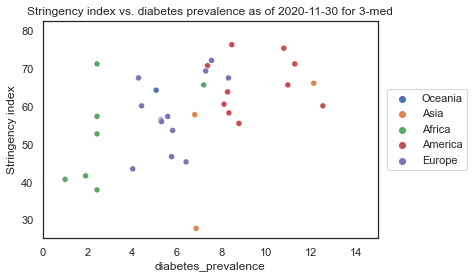

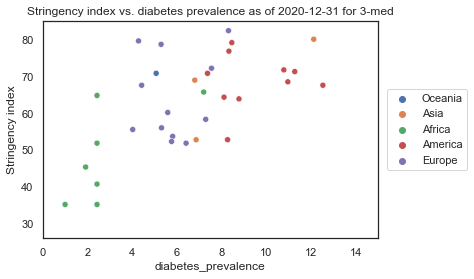

In [58]:
for grp in str_grp_list:
    for date in month_ends_2020:
        subset = clean_data[(clean_data['str_grp']==grp) & (clean_data['date']==date)]
        fig, ax = plt.subplots(1,1)
        sns.scatterplot(x='diabetes_prevalence', y='stringency_index', hue='continent', data=subset)
        plt.xlabel('diabetes_prevalence')
        plt.ylabel('Stringency index')
        title = 'Stringency index vs. diabetes prevalence as of '+ date + ' for ' + grp
        plt.xlim(0,15)
        plt.title(title)
        plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

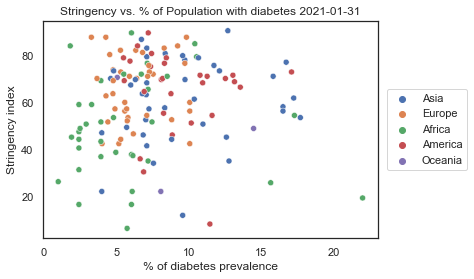

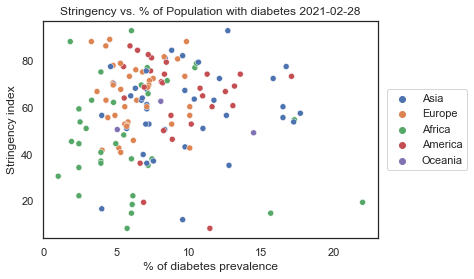

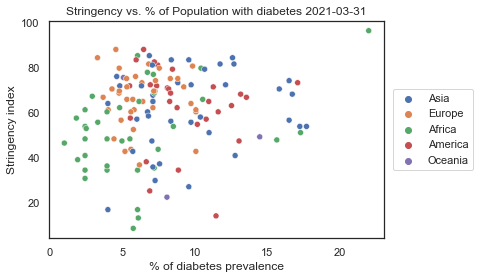

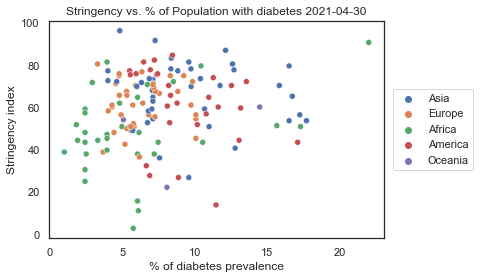

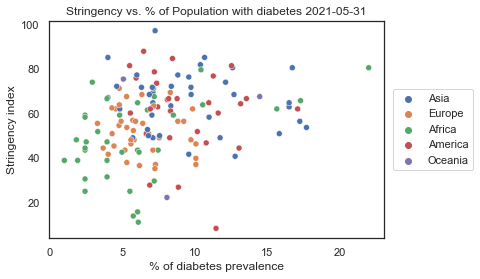

...

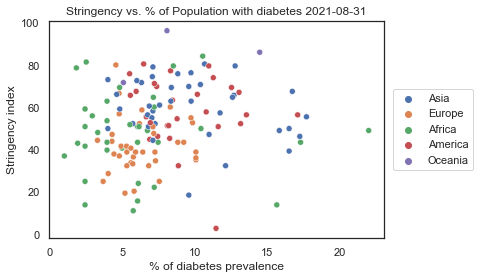

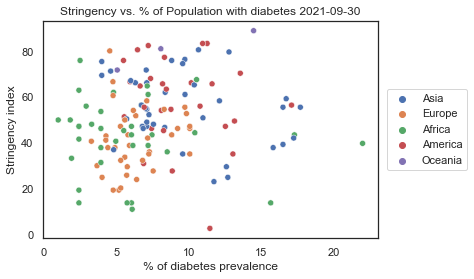

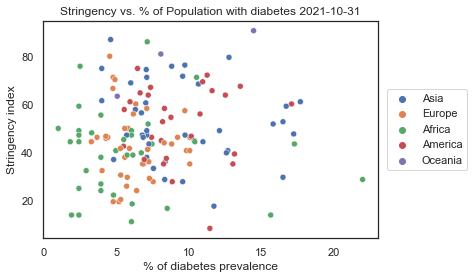

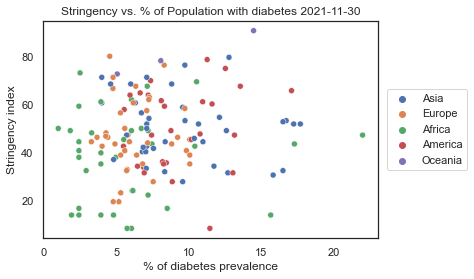

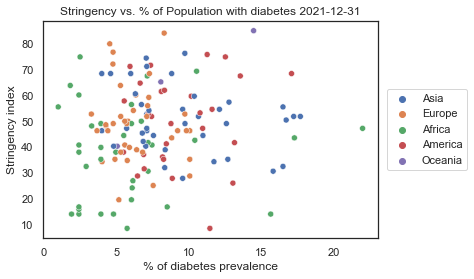

In [59]:
# 2021 Diabetes prevalence vs stringency, color by continent
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='diabetes_prevalence', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('% of diabetes prevalence')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. % of Population with diabetes '+date
    plt.title(title)
#     plt.xscale('log')
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

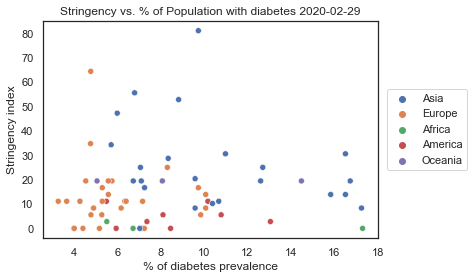

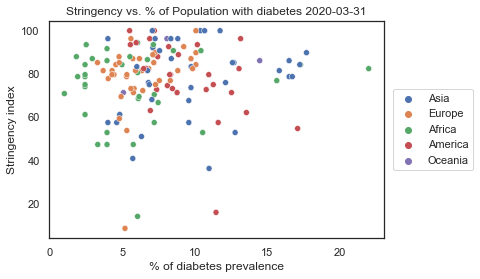

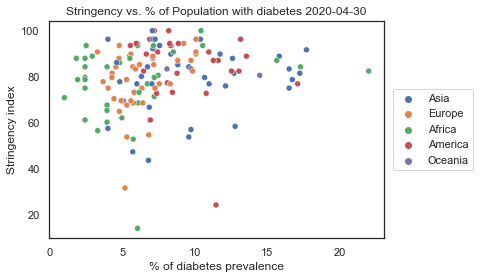

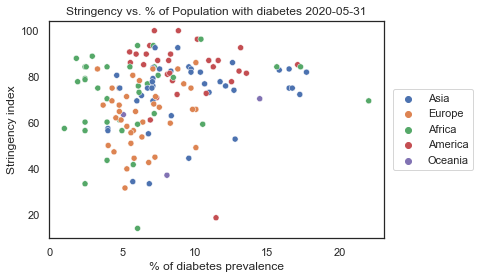

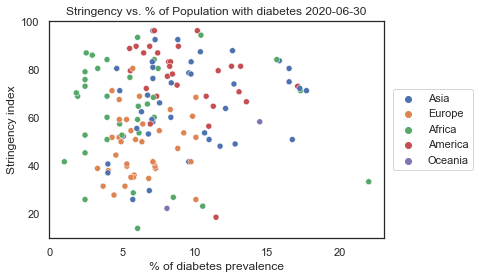

...

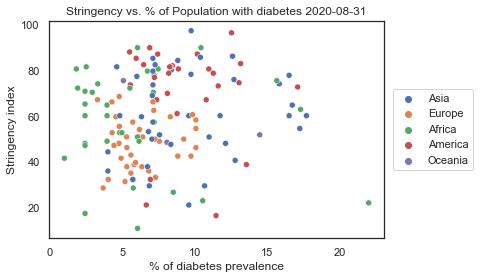

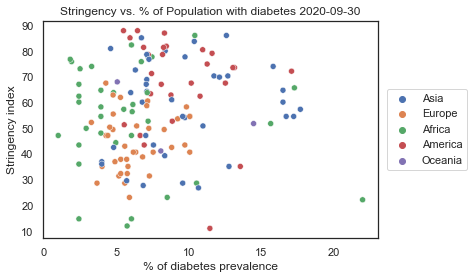

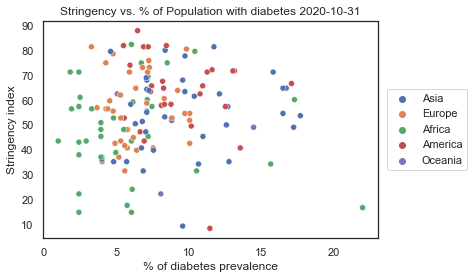

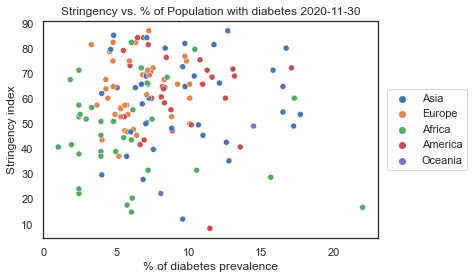

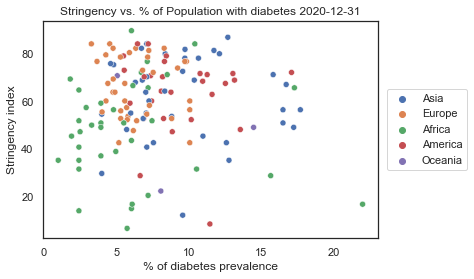

In [60]:
# 2020 Diabetes prevalence vs stringency, color by continent
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='diabetes_prevalence', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('% of diabetes prevalence')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. % of Population with diabetes '+date
    plt.title(title)
#     plt.xscale('log')
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

<div style="padding:10px;background-color: cornflowerblue; color:white;font-size:24px;">Stringency Analysis by Stringency Group</div>

In [61]:
month_end_data_2020 = month_end_data_2020.sort_values(by = ['str_grp','date'])
month_end_data_2021 = month_end_data_2021.sort_values(by = ['str_grp','date'])

month_end_data = pd.concat([month_end_data_2020, month_end_data_2021])

In [62]:
# Change these to see different graphs
plt_title = 'Stringency VS Population Density'
var_x = 'population_density'
x_name = 'Population Density'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'str_grp'
group_name = 'Stringency Group'
theme = 'ggplot2'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=True, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

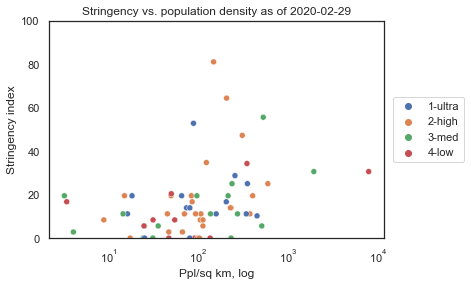

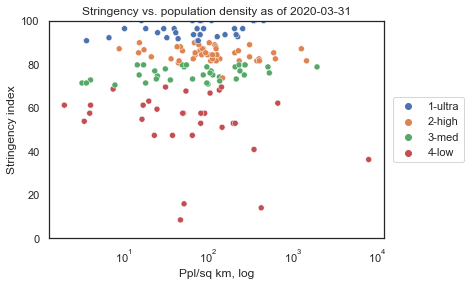

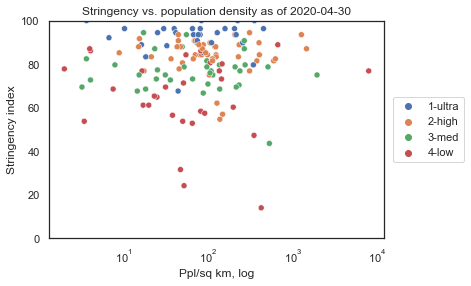

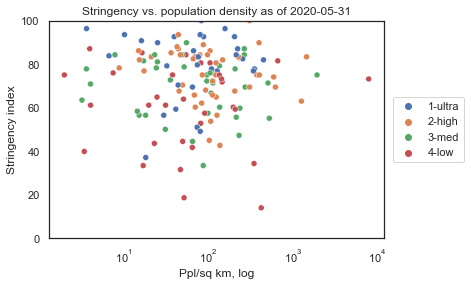

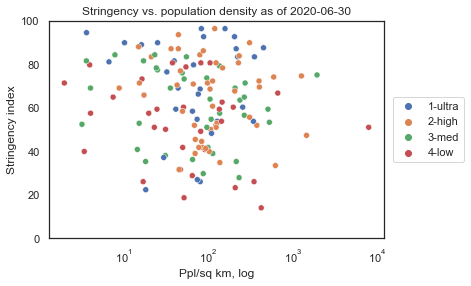

...

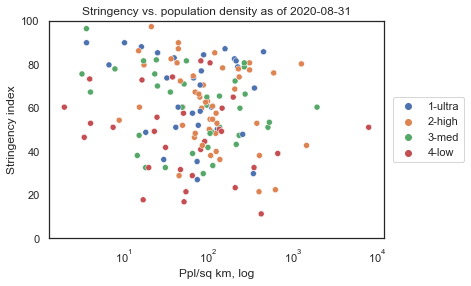

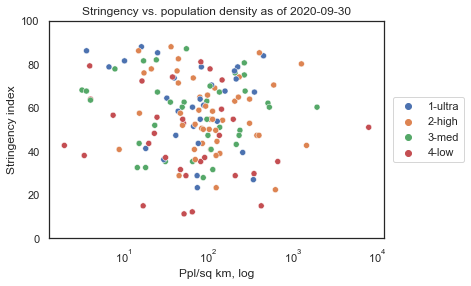

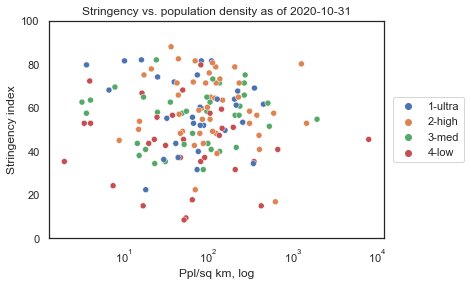

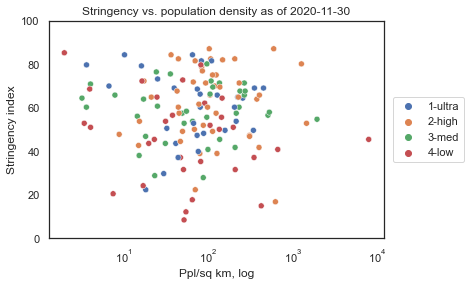

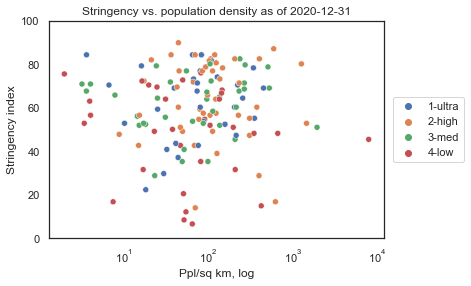

In [63]:
# 2020 population density vs stringency, color by stringency group
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]  
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='population_density', y='stringency_index', hue='str_grp', data=subset)
    plt.xlabel('Ppl/sq km, log')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. population density as of '+date
    plt.title(title)
    ax.set_ylim(0,100)
    plt.xscale('log')
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

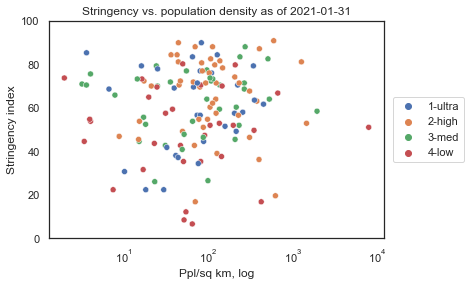

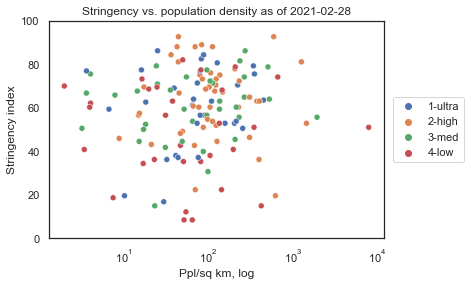

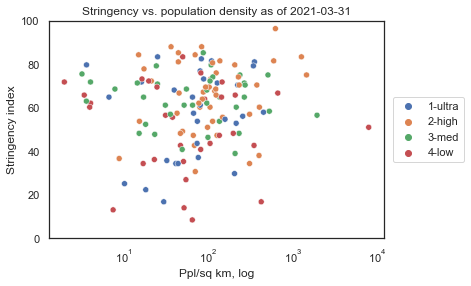

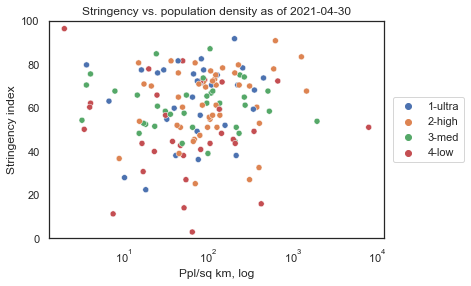

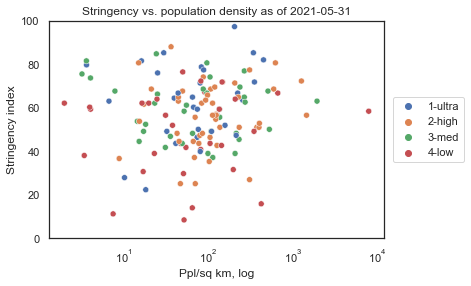

...

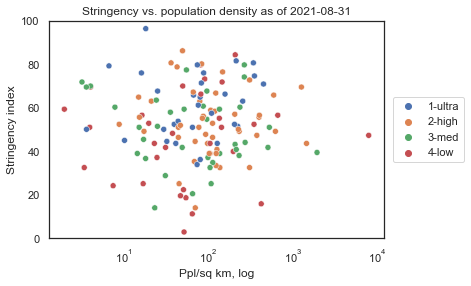

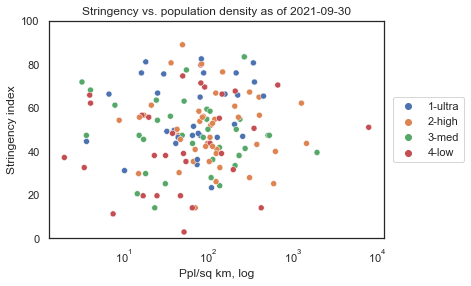

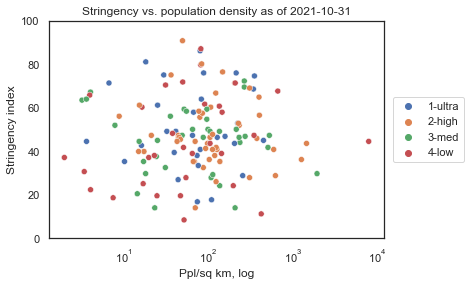

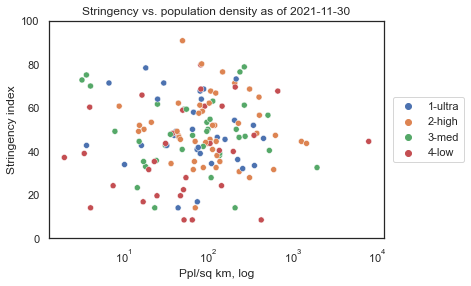

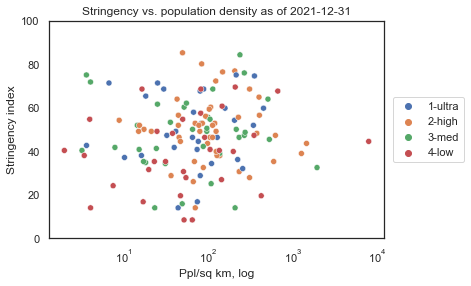

In [64]:
# 2021 population density vs stringency, color by stringency group
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='population_density', y='stringency_index', hue='str_grp', data=subset)
    plt.xlabel('Ppl/sq km, log')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. population density as of '+date
    plt.title(title)
    ax.set_ylim(0,100)
    plt.xscale('log')
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

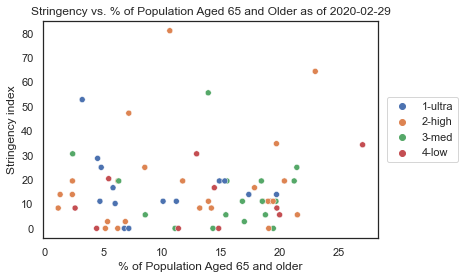

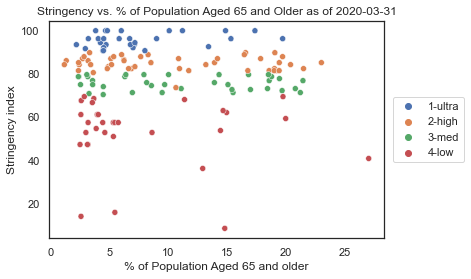

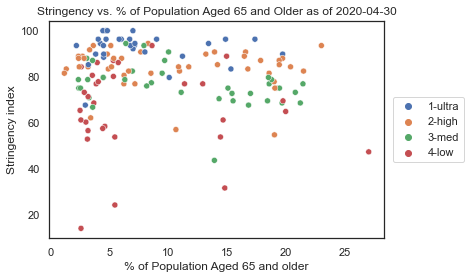

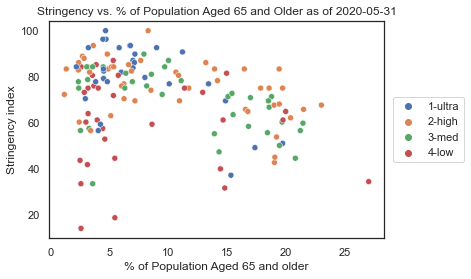

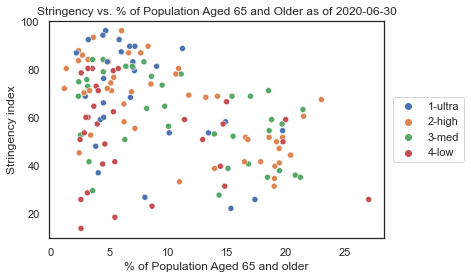

...

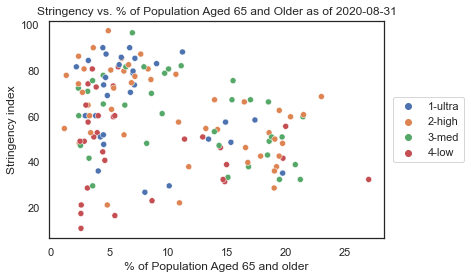

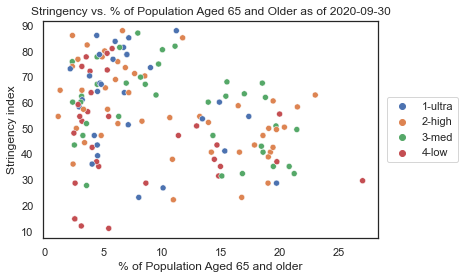

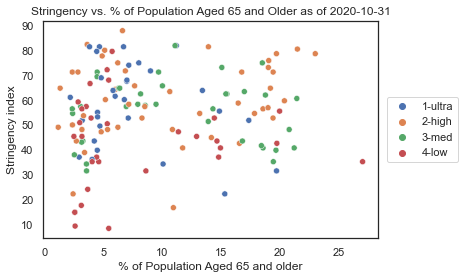

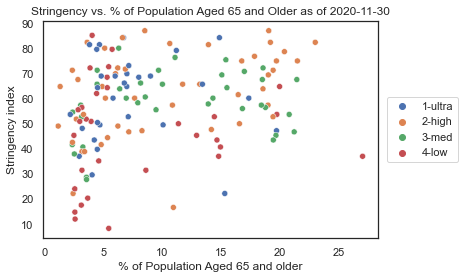

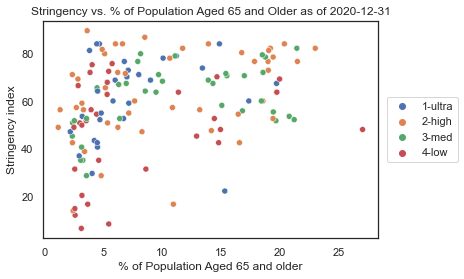

In [65]:
# 2020 Population Aged 65 and older vs stringency, color by stringency group
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='aged_65_older', y='stringency_index', hue='str_grp', data=subset)
    plt.xlabel('% of Population Aged 65 and older')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. % of Population Aged 65 and Older as of '+date
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

hdi_grp     low_hdi    med_hdi   high_hdi  ultra_hdi
ppnd_grp                                            
low_pd    43.518364  64.400414  65.001436  50.189952
med_pd    50.892830  57.101955  55.387637  56.749710
high_pd   57.705779  64.784246  58.312848  58.374301
ultra_pd  55.594279  65.904684  60.074500  55.956436


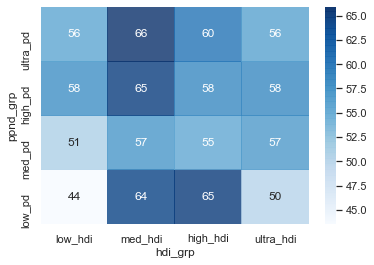

In [66]:
# Experimental heat map for average stringency in different HDI and population density groups from Jan 2020 to Oct 2021
subset = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021))]

#print(subset.date.head())
ppnhdi = subset.groupby(['ppnd_grp', 'hdi_grp'])['stringency_index'].mean().unstack()
#print(type(ppnhdi))
print(ppnhdi)

ax=sns.heatmap(ppnhdi, annot=True, cmap='Blues', alpha=0.8)
ax.invert_yaxis()

hdi_grp   low_hdi  med_hdi  high_hdi  ultra_hdi
ppnd_grp                                       
low_pd          5       12         8          9
med_pd         12        8        13          3
high_pd         9        8         7         12
ultra_pd        9        7         8         12


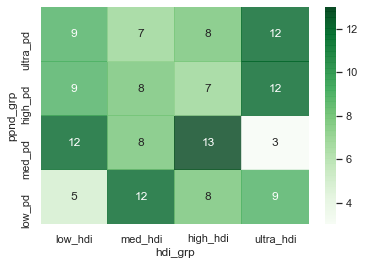

In [67]:
# To see how many countries are in each HDI/PPN group
ppnhdi_c = subset.groupby(['ppnd_grp', 'hdi_grp'])['location'].nunique().unstack()
print(ppnhdi_c)

ax=sns.heatmap(ppnhdi_c, annot=True, cmap='Greens', alpha=0.8)
ax.invert_yaxis()

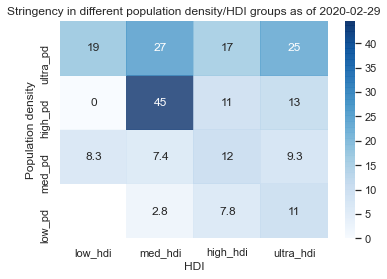

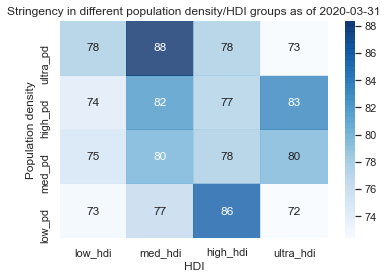

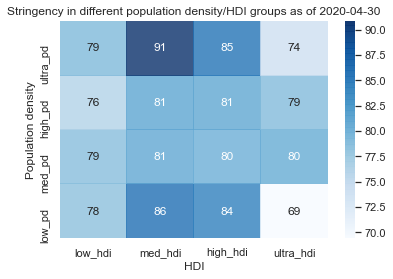

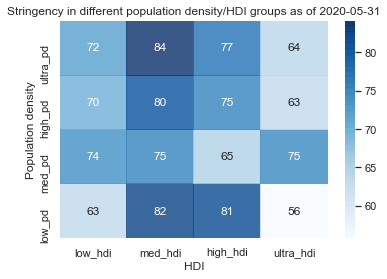

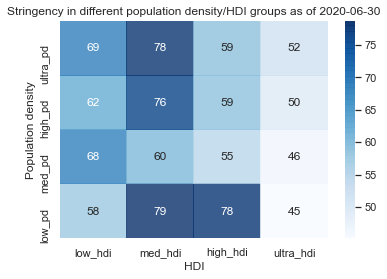

...

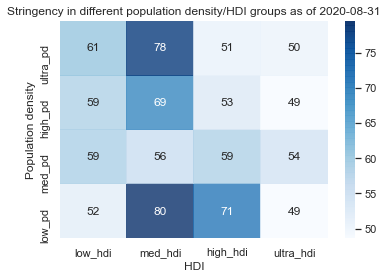

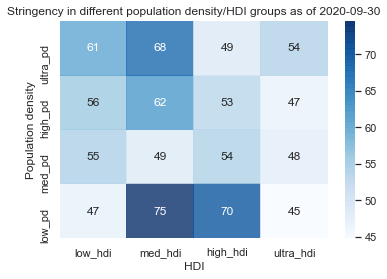

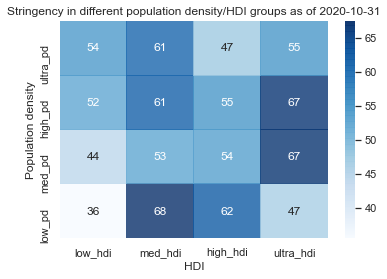

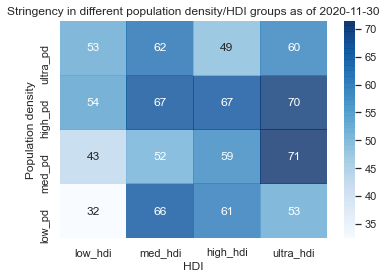

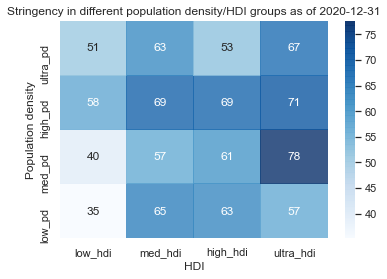

In [68]:
# Heat map in 2020
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    ppnhdi = subset.groupby(['ppnd_grp', 'hdi_grp'])['stringency_index'].mean().unstack()
    ax = sns.heatmap(ppnhdi, annot=True, cmap='Blues', alpha=0.8)
    ax.invert_yaxis()
    plt.xlabel('HDI')
    plt.ylabel('Population density')
    title = 'Stringency in different population density/HDI groups as of '+date
    plt.title(title)

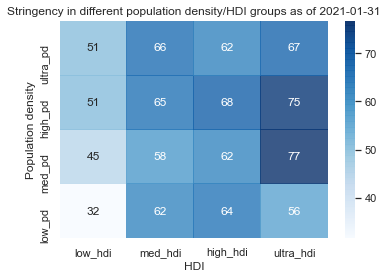

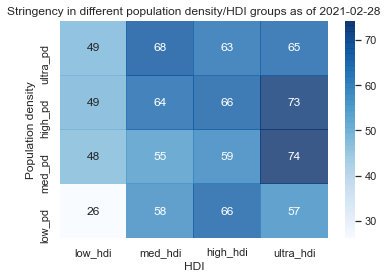

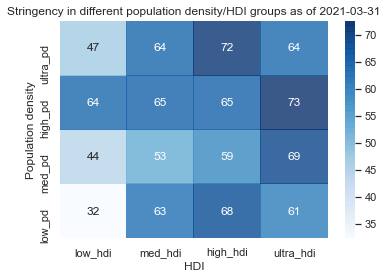

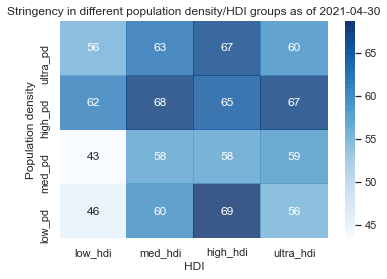

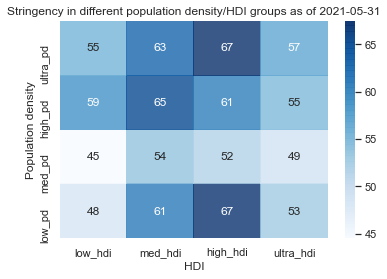

...

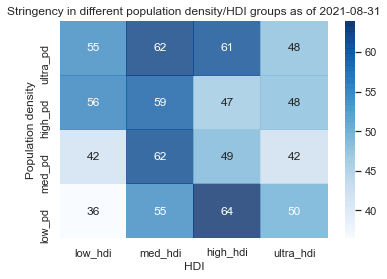

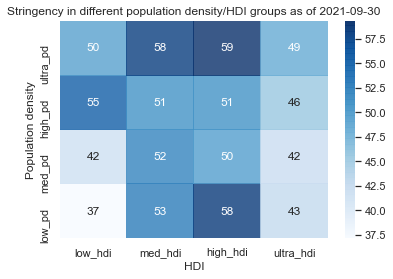

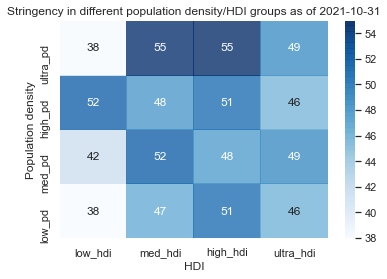

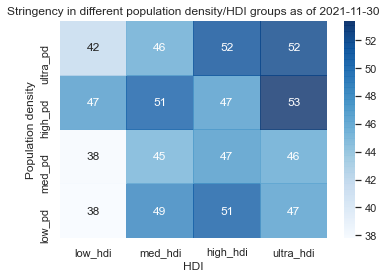

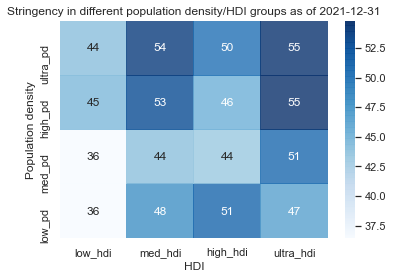

In [69]:
# Stringency in population density/HDI blocks in 2021
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    ppnhdi = subset.groupby(['ppnd_grp', 'hdi_grp'])['stringency_index'].mean().unstack()
    ax = sns.heatmap(ppnhdi, annot=True, cmap='Blues', alpha=0.8)
    ax.invert_yaxis()
    plt.xlabel('HDI')
    plt.ylabel('Population density')
    title = 'Stringency in different population density/HDI groups as of '+date
    plt.title(title)

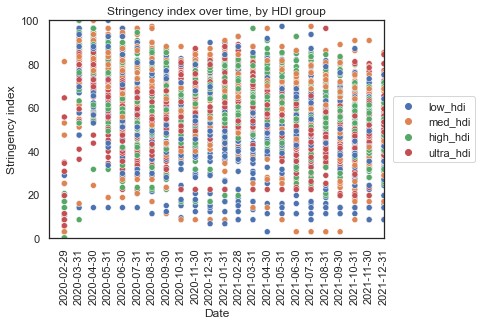

In [70]:
# Look at stringency overtime by HDI group
subset = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021))]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', hue='hdi_grp', data=subset)
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, by HDI group'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

Text(0.5, 1.0, 'Stringency index over time, low HDI group')

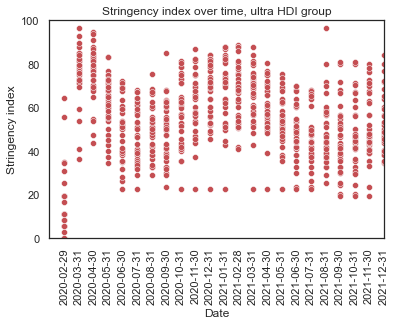

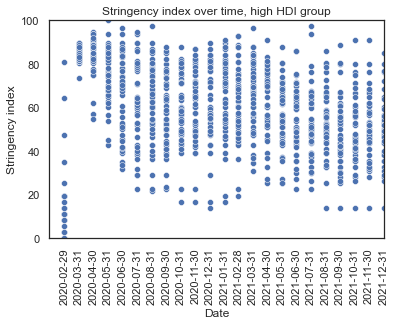

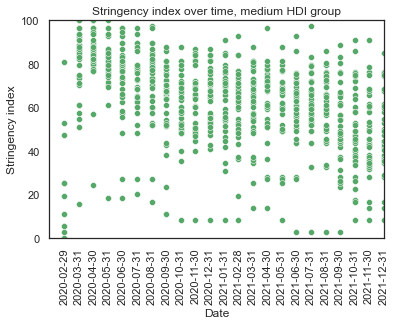

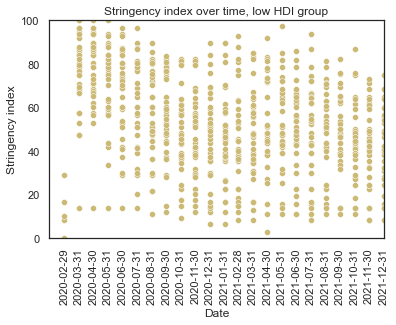

In [71]:
# time on x-axis, stringency on y-axis, see by HDI group individually

# ultra HDI
subsetHDI4 = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['hdi_grp']=='ultra_hdi')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetHDI4, color = 'r')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, ultra HDI group'
plt.title(title)

# High HDI
subsetHDI3 = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['hdi_grp']=='high_hdi')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetHigh, color = 'b')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, high HDI group'
plt.title(title)

# Med HDI
subsetMed = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['hdi_grp']=='med_hdi')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetMed, color = 'g')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, medium HDI group'
plt.title(title)

# low HDI
subsetLow = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021)) & (clean_data['hdi_grp']=='low_hdi')]

fig, ax = plt.subplots(1,1)
sns.scatterplot(y='stringency_index', x='date', data=subsetLow, color = 'y')
plt.ylabel('Stringency index')
plt.xlabel('Date')

ax.set_xlim([pd.to_datetime('2020-01-28'), pd.to_datetime('2021-11-27')])
ax.set_ylim(0,100)
plt.xticks(subset['date'].drop_duplicates(), rotation = 'vertical')

title = 'Stringency index over time, low HDI group'
plt.title(title)

In [72]:
# See how positivity rate changed per stringency group
by_pos = pd.DataFrame(clean_data.groupby('str_grp')['positive_rate'].mean())
print(by_pos.sort_values(by='positive_rate'))

subset = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021))]
by_pos_date = subset.groupby(['date', 'str_grp'])['positive_rate'].mean().unstack()

# When a column is backed by DateTimeIndex, then panda does not convert it to an Index of string objects.
# The unstack() (and pivot too actually) creates CategoricalIndex for the columns
# Then it does not let you do reset_index(). Must reset columns to string
# otherwise gets TypeError "cannot insert an item into a CategoricalIndex that is not already an existing category"
by_pos_date = by_pos_date.rename(columns=str).reset_index()
by_pos_date.columns
by_pos_date

         positive_rate
str_grp               
4-low         0.072355
3-med         0.072775
2-high        0.085759
1-ultra       0.113005


str_grp,date,1-ultra,2-high,3-med,4-low
0,2020-02-29,0.018000,0.001638,0.028033,0.067200
1,2020-03-31,0.122779,0.076000,0.073444,0.044722
2,2020-04-30,0.079617,0.052025,0.049829,0.041664
3,2020-05-31,0.110758,0.060693,0.042400,0.032221
4,2020-06-30,0.135900,0.088800,0.049921,0.033143
5,2020-07-31,0.148645,0.091828,0.052340,0.053340
6,2020-08-31,0.121805,0.074078,0.069725,0.035933
7,2020-09-30,0.112660,0.074944,0.087392,0.048607
8,2020-10-31,0.118365,0.135958,0.102592,0.050433
9,2020-11-30,0.123805,0.138381,0.120984,0.063275


Index(['date', '1-ultra', '2-high', '3-med', '4-low'], dtype='object', name='str_grp')
str_grp
date       datetime64[ns]
1-ultra           float64
2-high            float64
3-med             float64
4-low             float64
dtype: object


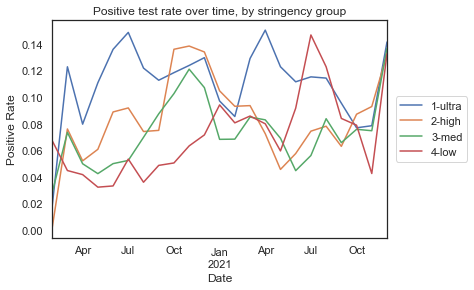

In [73]:
# Look at positivity over time by stringency group
print(by_pos_date.columns)
print(by_pos_date.dtypes)
by_pos_date.plot(kind='line', x='date', y=['1-ultra','2-high','3-med','4-low'])
plt.ylabel('Positive Rate')
plt.xlabel('Date')

title = 'Positive test rate over time, by stringency group'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [74]:
# Vaccination explorations
subset21 = clean_data[(clean_data['date'].isin(month_ends_2021))]

vaxx1 = subset21.groupby(['date','str_grp'])['people_vaccinated_per_hundred'].mean().unstack()
vaxx2 = subset21.groupby(['date','str_grp'])['people_fully_vaccinated_per_hundred'].mean().unstack()

vaxx1 = vaxx1.rename(columns=str).reset_index()
vaxx2 = vaxx2.rename(columns=str).reset_index()

print(vaxx1)
print(vaxx2)


str_grp       date    1-ultra     2-high      3-med      4-low
0       2021-01-31   0.386000   1.752340   1.718889   1.323871
1       2021-02-28   1.351333   3.798936   4.540556   2.911613
2       2021-03-31   3.215667   8.190426   9.443056   5.864194
3       2021-04-30   5.985333  14.103830  15.723889   9.936774
4       2021-05-31  10.798667  20.261277  22.951389  15.325806
5       2021-06-30  15.327000  28.225319  31.883611  19.910323
6       2021-07-31  22.804667  35.000426  39.184722  24.896452
7       2021-08-31  30.614000  41.750213  44.936944  29.874839
8       2021-09-30  36.489000  45.673830  49.065833  34.512581
9       2021-10-31  40.551333  48.614468  51.752778  39.566129
10      2021-11-30  44.655333  52.503191  53.922778  44.265484
11      2021-12-31  48.230667  55.364681  56.232778  46.987742
str_grp       date    1-ultra     2-high      3-med      4-low
0       2021-01-31   0.036667   0.670851   0.234722   0.066452
1       2021-02-28   0.435000   2.167872   1.125278   1

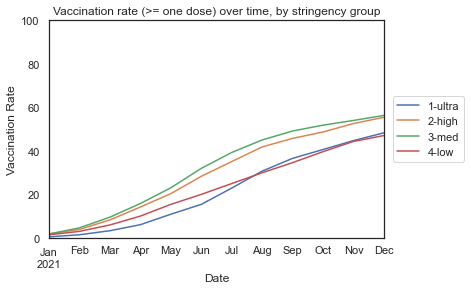

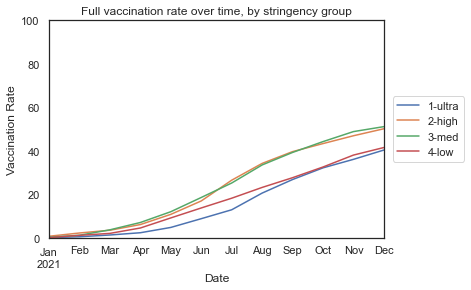

In [75]:
# Look at vaccination over time by stringency group

vaxx1.plot(kind='line', x='date', y=['1-ultra','2-high','3-med','4-low'])
plt.ylabel('Vaccination Rate')
plt.xlabel('Date')

title = 'Vaccination rate (>= one dose) over time, by stringency group'
plt.title(title)
plt.ylim(0,100)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

vaxx2.plot(kind='line', x='date', y=['1-ultra','2-high','3-med','4-low'])
plt.ylabel('Vaccination Rate')
plt.xlabel('Date')

title = 'Full vaccination rate over time, by stringency group'
plt.title(title)
plt.ylim(0,100)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')


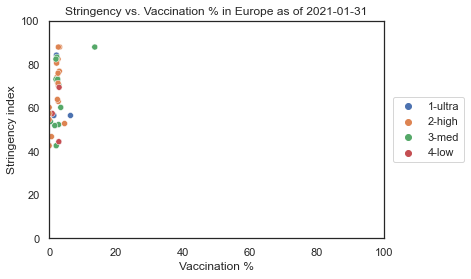

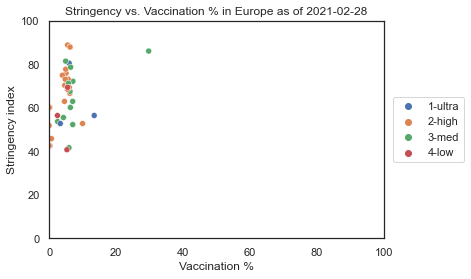

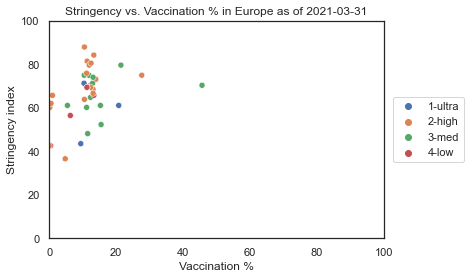

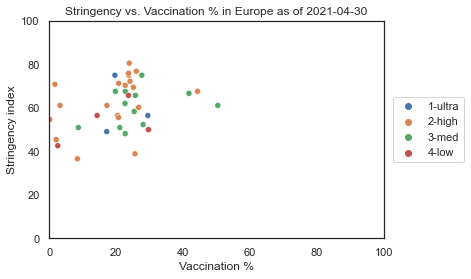

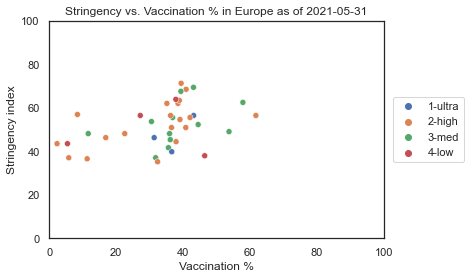

...

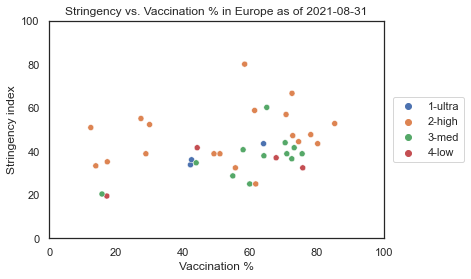

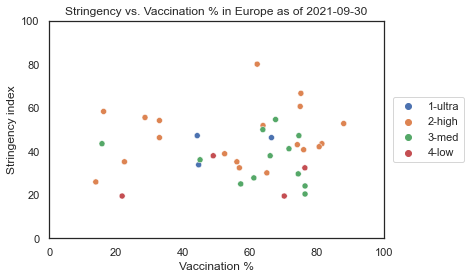

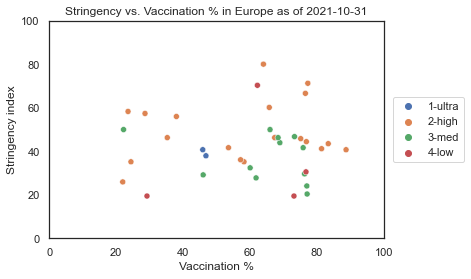

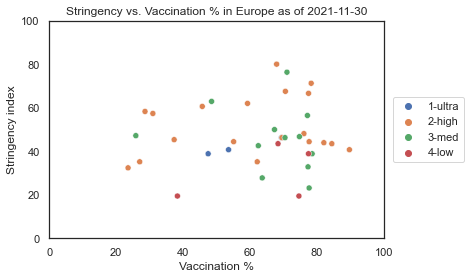

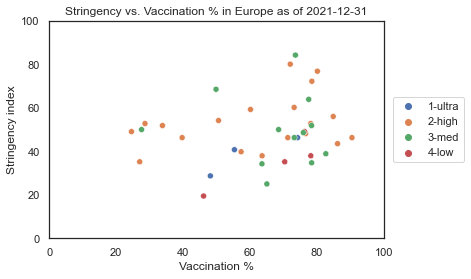

In [76]:
# Just Europe
for date in month_ends_2021:
    subset = clean_data[(clean_data['date']==date) & (clean_data['continent']=='Europe')]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='people_vaccinated_per_hundred', y='stringency_index', hue='str_grp', data=subset)
    plt.xlabel('Vaccination %')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. Vaccination % in Europe as of '+date
    plt.xlim(0,100)
    plt.ylim(0,100)
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [77]:
# Vaccination explorations
subset21 = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021))]
subset21U = subset21[subset21['str_grp']=='1-ultra']
subset21H = subset21[subset21['str_grp']=='2-high']
subset21M = subset21[subset21['str_grp']=='3-med']
subset21L = subset21[subset21['str_grp']=='4-low']

vaxU = pd.DataFrame(subset21U.groupby(['date'])['people_vaccinated_per_hundred',
                                                 'people_fully_vaccinated_per_hundred','stringency_index'].mean())

vaxH = pd.DataFrame(subset21H.groupby(['date'])['people_vaccinated_per_hundred',
                                                 'people_fully_vaccinated_per_hundred','stringency_index'].mean())

vaxM = pd.DataFrame(subset21M.groupby(['date'])['people_vaccinated_per_hundred',
                                                 'people_fully_vaccinated_per_hundred','stringency_index'].mean())

vaxL = pd.DataFrame(subset21L.groupby(['date'])['people_vaccinated_per_hundred',
                                                 'people_fully_vaccinated_per_hundred','stringency_index'].mean())

vaxU = vaxU.reset_index()
vaxH = vaxH.reset_index()
vaxM = vaxM.reset_index()
vaxL = vaxL.reset_index()


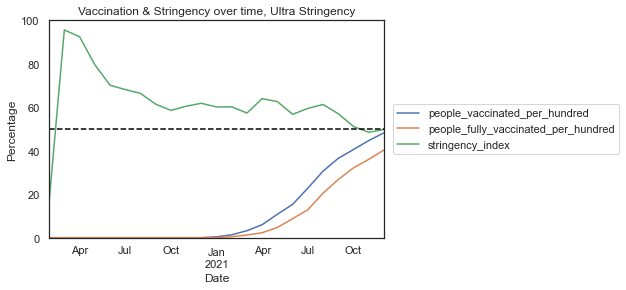

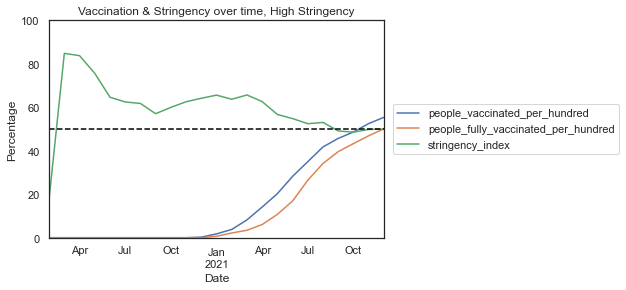

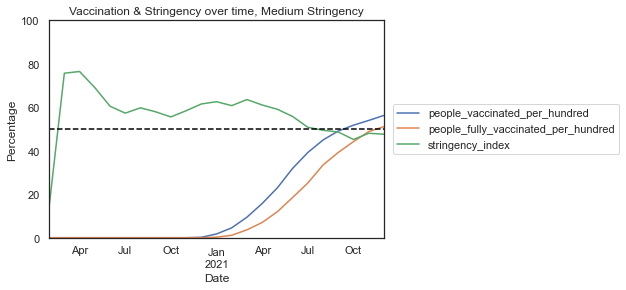

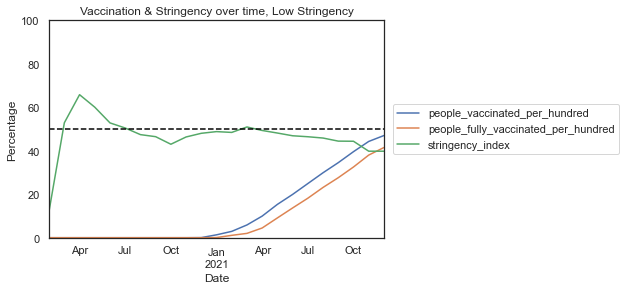

In [78]:
# Make chart of vaccination against stringency for each stringency group
vaxU.plot(kind='line', x='date', y=['people_vaccinated_per_hundred',
                                      'people_fully_vaccinated_per_hundred','stringency_index'])
plt.ylabel('Percentage')
plt.xlabel('Date')
plt.ylim(0,100)
title = 'Vaccination & Stringency over time, Ultra Stringency'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')
plt.axhline(y=50, color='black', linestyle = '--')

vaxH.plot(kind='line', x='date', y=['people_vaccinated_per_hundred',
                                      'people_fully_vaccinated_per_hundred','stringency_index'])
plt.ylabel('Percentage')
plt.xlabel('Date')
plt.ylim(0,100)
title = 'Vaccination & Stringency over time, High Stringency'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')
plt.axhline(y=50, color='black', linestyle = '--')

vaxM.plot(kind='line', x='date', y=['people_vaccinated_per_hundred',
                                      'people_fully_vaccinated_per_hundred','stringency_index'])
plt.ylabel('Percentage')
plt.xlabel('Date')
plt.ylim(0,100)
title = 'Vaccination & Stringency over time, Medium Stringency'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')
plt.axhline(y=50, color='black', linestyle = '--')

vaxL.plot(kind='line', x='date', y=['people_vaccinated_per_hundred',
                                      'people_fully_vaccinated_per_hundred','stringency_index'])
plt.ylabel('Percentage')
plt.xlabel('Date')
plt.ylim(0,100)
title = 'Vaccination & Stringency over time, Low Stringency'
plt.title(title)
plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')
plt.axhline(y=50, color='black', linestyle = '--')

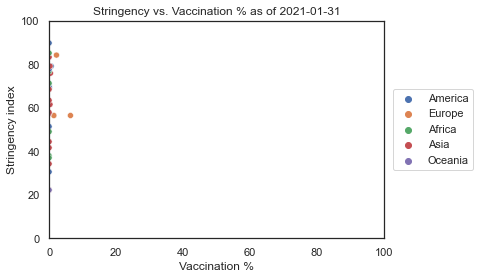

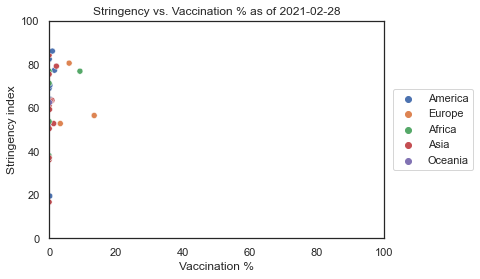

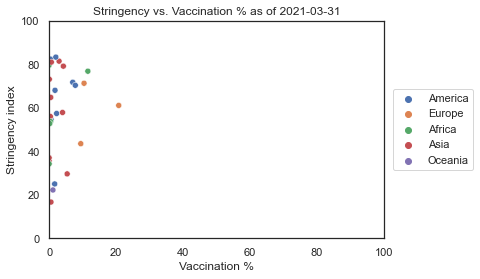

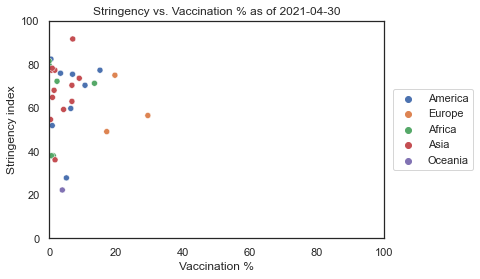

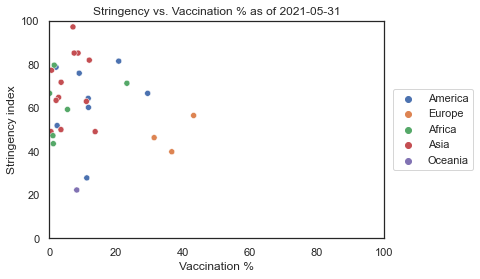

...

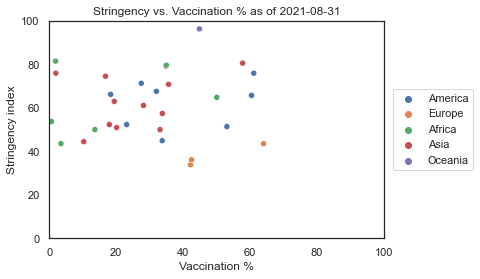

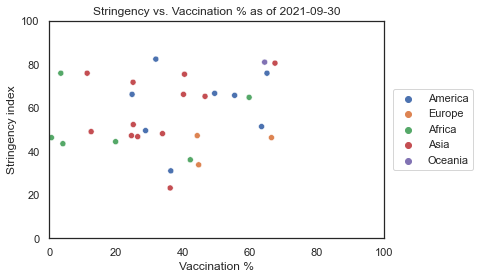

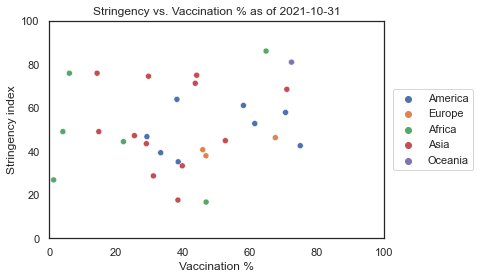

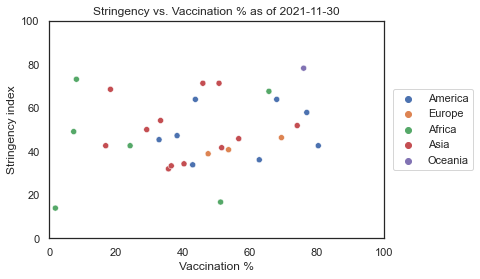

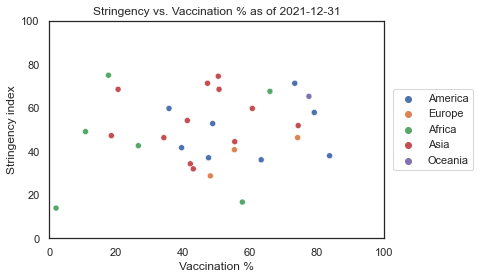

In [79]:
# Ultra group's vaccination vs stringency overtime
for date in month_ends_2021:
    subset = clean_data[(clean_data['date']==date) & (clean_data['str_grp']=='1-ultra')]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='people_vaccinated_per_hundred', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Vaccination %')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. Vaccination % as of '+date
    plt.xlim(0,100)
    plt.ylim(0,100)
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

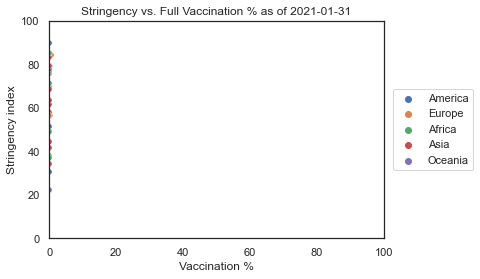

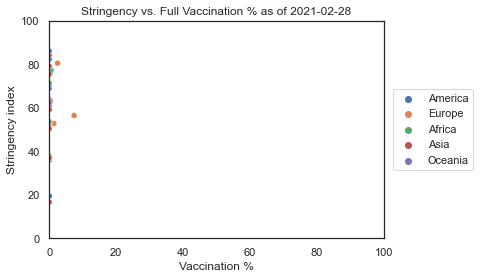

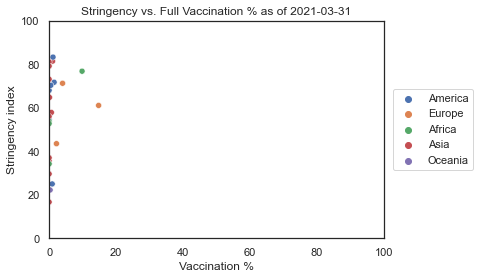

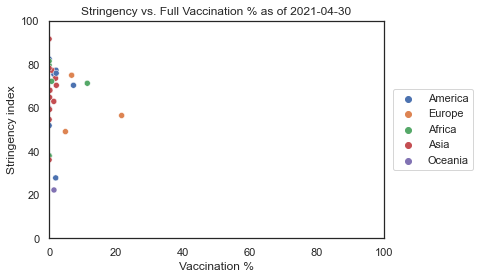

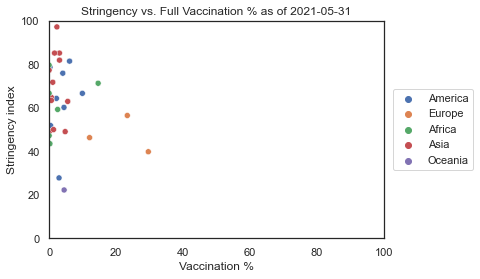

...

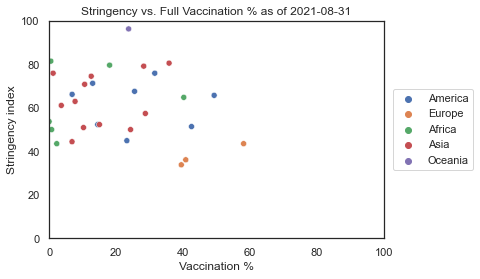

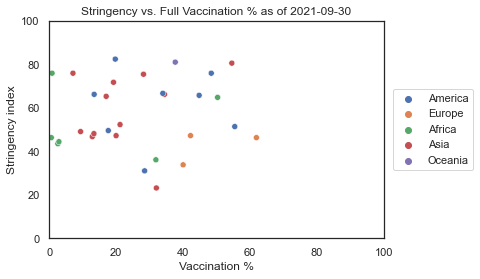

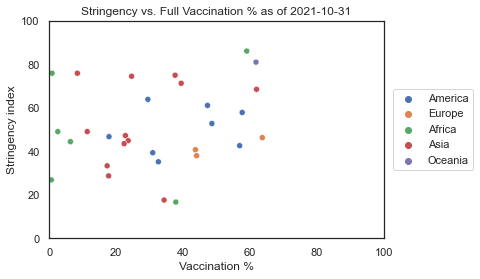

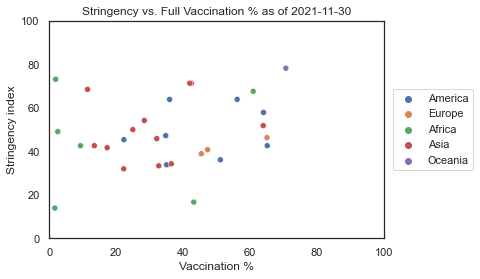

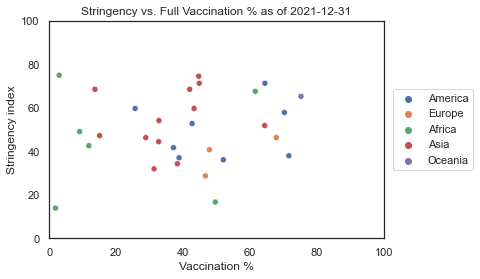

In [80]:
# Ultra group's vaccination vs stringency overtime
for date in month_ends_2021:
    subset = clean_data[(clean_data['date']==date) & (clean_data['str_grp']=='1-ultra')]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='people_fully_vaccinated_per_hundred', y='stringency_index', hue='continent', data=subset)
    plt.xlabel('Vaccination %')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. Full Vaccination % as of '+date
    plt.xlim(0,100)
    plt.ylim(0,100)
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

In [81]:
# Change these to see different graphs
plt_title = 'Stringency VS % of Population Aged 65 and older'
var_x = 'aged_65_older'
x_name = 'Aged 65 and Older (per hundred)'
var_y = 'stringency_index'
y_name = 'Stringency Index'
group = 'str_grp'
group_name = 'Stringency Group'
theme = 'ggplot2'

# Automatic limits. You can change this manually
max_x = month_end_data[var_x].max() * 1.1
max_y = 100

# Constructing the graph
fig = px.scatter(month_end_data, y=var_y, x=var_x, template = theme,
                 animation_frame= 'date', animation_group="location",
                 size= 'size', color= group, hover_name="location",
                 log_x=False, size_max = 10, range_y=[0.01,max_y], range_x=[0.01,max_x])

fig.update_layout(title=plt_title,
                  xaxis_title= x_name,
                  yaxis_title= y_name,
                  legend_title= group_name,
                  font = dict(family="Courier New, monospace",
                              size= 12),
                  title_font_color = 'cornflowerblue', 
                  title_font_size = 30)
    
fig.show()

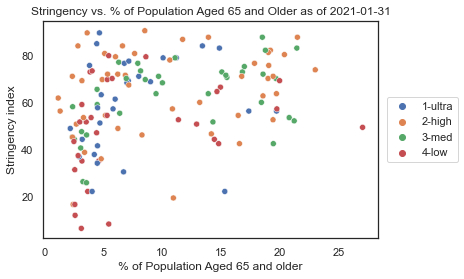

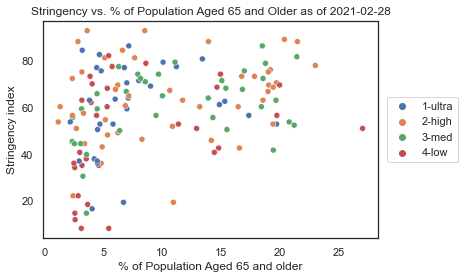

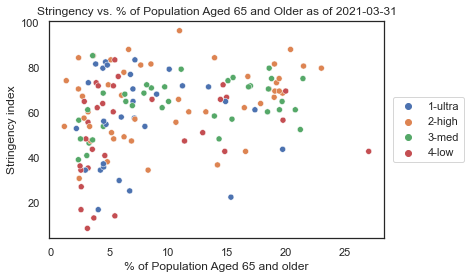

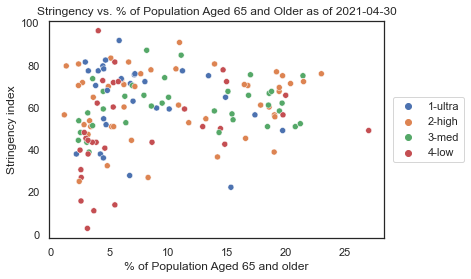

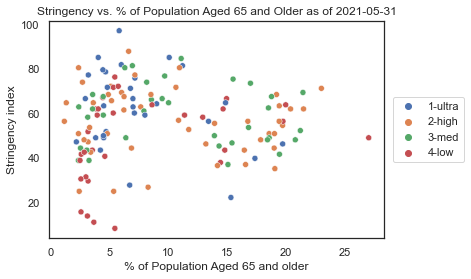

...

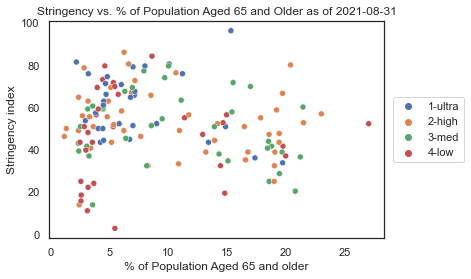

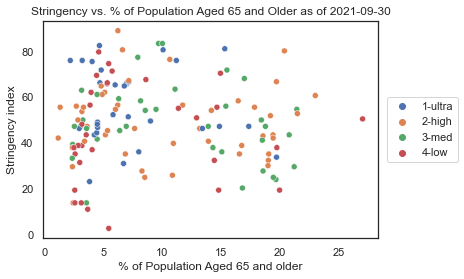

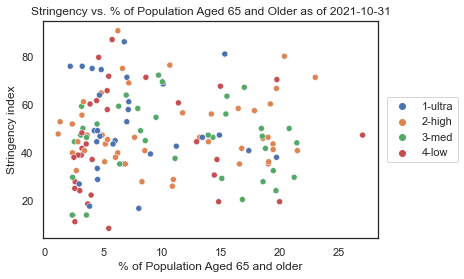

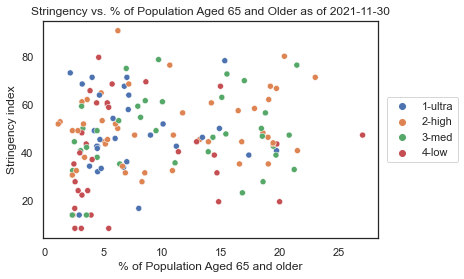

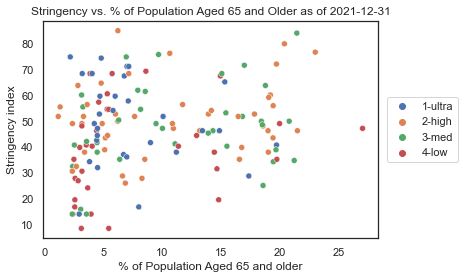

In [82]:
# 2021 Population Aged 65 and older vs stringency, color by stringency group
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    sns.scatterplot(x='aged_65_older', y='stringency_index', hue='str_grp', data=subset)
    plt.xlabel('% of Population Aged 65 and older')
    plt.ylabel('Stringency index')
    title = 'Stringency vs. % of Population Aged 65 and Older as of '+date
    plt.title(title)
    plt.legend(bbox_to_anchor = (1.01, 0.5), loc = 'center left')

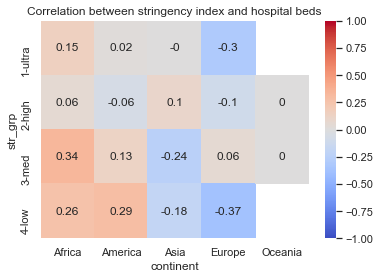

In [83]:
df_hospital_beds = pd.DataFrame(columns=['str_grp','continent','correlation'])

for grp in str_grp_list:
    for con in continent_list:
        subset = clean_data[(clean_data['str_grp']==grp) & (clean_data['continent']==con)]
        cor = np.round(subset['stringency_index'].corr(subset['hospital_beds_per_thousand']),decimals=2)
#         np.round(df_hospital_beds_pivot, decimals=2)
        df_hospital_beds = df_hospital_beds.append(pd.Series([grp, con, cor], index=df_hospital_beds.columns), ignore_index=True)

df_hospital_beds_pivot = df_hospital_beds.pivot('str_grp', 'continent', 'correlation')
ax = sns.heatmap(df_hospital_beds_pivot,vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm').set(title='Correlation between stringency index and hospital beds')

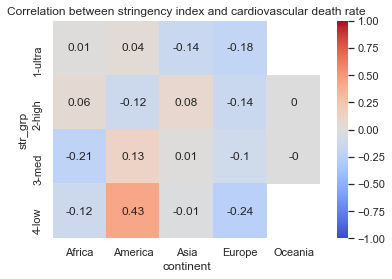

In [84]:
df_cdr = pd.DataFrame(columns=['str_grp','continent','correlation'])

for grp in str_grp_list:
    for con in continent_list:
        subset = clean_data[(clean_data['str_grp']==grp) & (clean_data['continent']==con)]
        cor = np.round(subset['stringency_index'].corr(subset['cardiovasc_death_rate']),decimals=2)
        df_cdr = df_cdr.append(pd.Series([grp, con, cor], index=df_cdr.columns), ignore_index=True)

df_cdr_pivot = df_cdr.pivot('str_grp', 'continent', 'correlation')
ax = sns.heatmap(df_cdr_pivot,vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm').set(title='Correlation between stringency index and cardiovascular death rate')

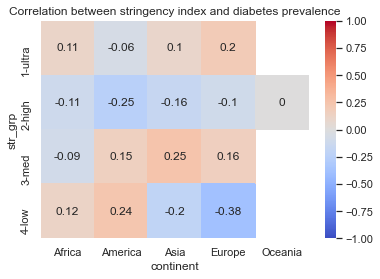

In [85]:
df_dp = pd.DataFrame(columns=['str_grp','continent','correlation'])

for grp in str_grp_list:
    for con in continent_list:
        subset = clean_data[(clean_data['str_grp']==grp) & (clean_data['continent']==con)]
        cor = np.round(subset['stringency_index'].corr(subset['diabetes_prevalence']), decimals=2)
        df_dp = df_dp.append(pd.Series([grp, con, cor], index=df_dp.columns), ignore_index=True)

df_dp_pivot = df_dp.pivot('str_grp', 'continent', 'correlation')
ax = sns.heatmap(df_dp_pivot,vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm').set(title='Correlation between stringency index and diabetes prevalence')

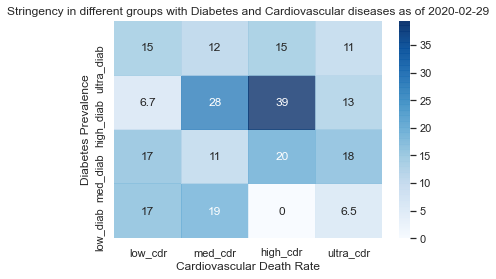

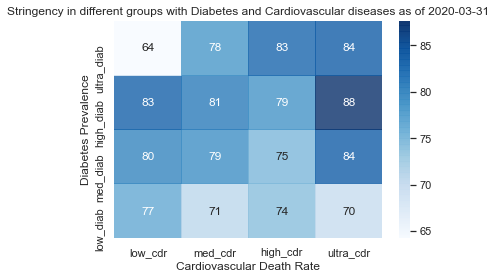

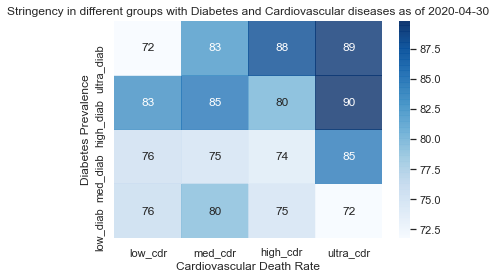

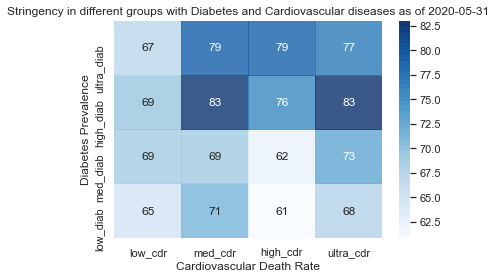

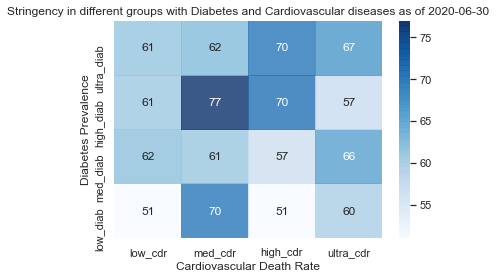

...

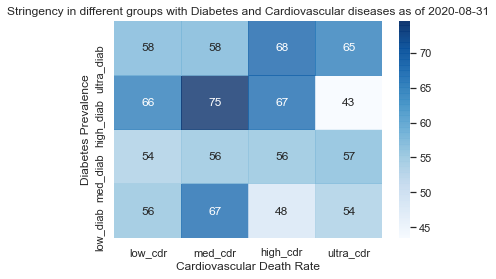

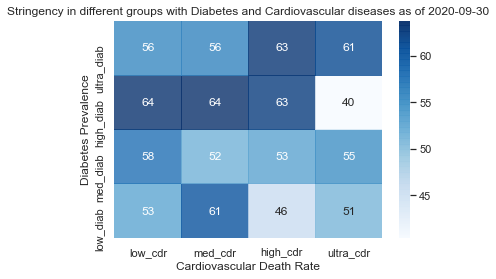

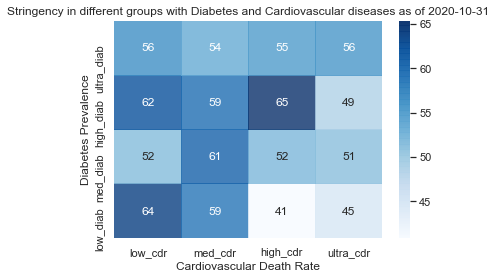

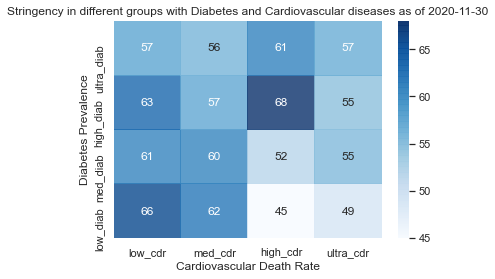

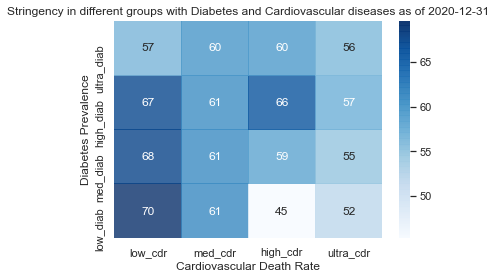

In [86]:
# Heat map in 2020
for date in month_ends_2020:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    cdrind = subset.groupby(['diab_grp', 'cdr_grp'])['stringency_index'].mean().unstack()
    ax = sns.heatmap(cdrind, annot=True, cmap='Blues', alpha=0.8)
    ax.invert_yaxis()
    plt.xlabel('Cardiovascular Death Rate')
    plt.ylabel('Diabetes Prevalence')
    title = 'Stringency in different groups with Diabetes and Cardiovascular diseases as of '+date
    plt.title(title)

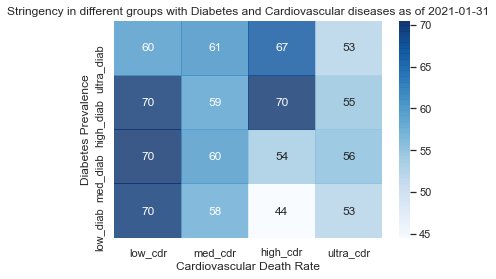

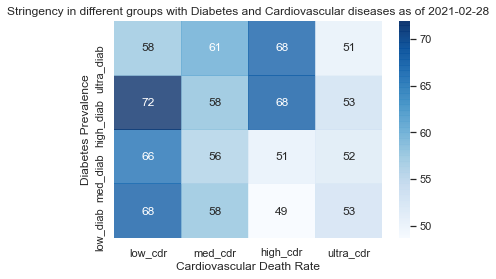

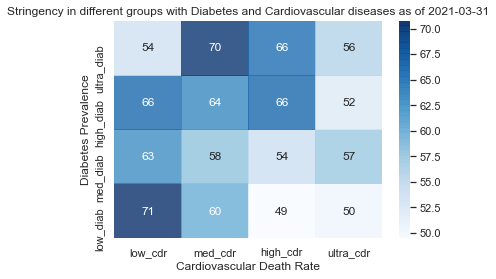

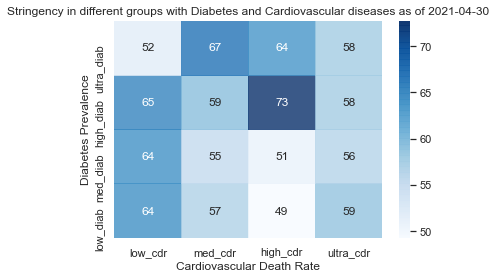

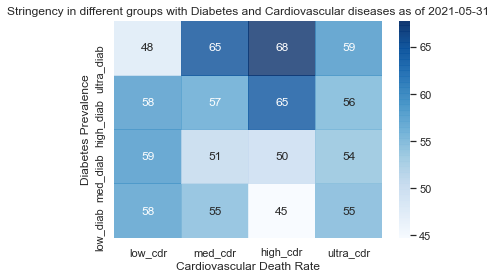

...

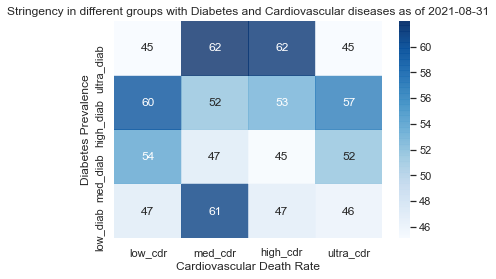

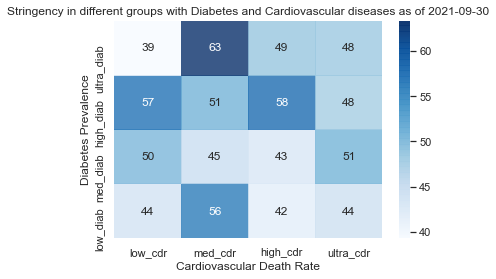

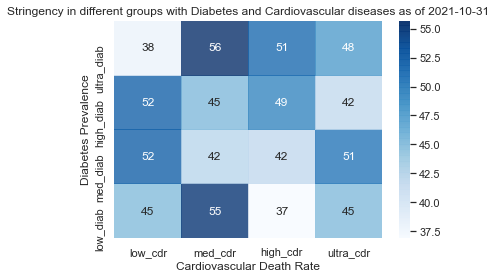

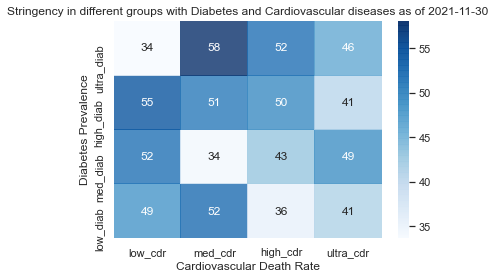

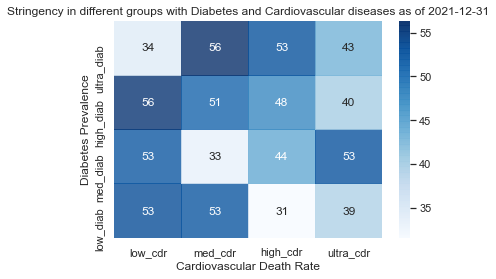

In [87]:
# Heat map in 2021
for date in month_ends_2021:
    subset = clean_data[clean_data['date']==date]
    fig, ax = plt.subplots(1,1)
    cdrind = subset.groupby(['diab_grp', 'cdr_grp'])['stringency_index'].mean().unstack()
    ax = sns.heatmap(cdrind, annot=True, cmap='Blues', alpha=0.8)
    ax.invert_yaxis()
    plt.xlabel('Cardiovascular Death Rate')
    plt.ylabel('Diabetes Prevalence')
    title = 'Stringency in different groups with Diabetes and Cardiovascular diseases as of '+date
    plt.title(title)

In [88]:
# See how positivity rate changed per stringency group
by_pos = pd.DataFrame(clean_data.groupby('str_grp')['positive_rate'].mean())
print(by_pos.sort_values(by='positive_rate'))

subset = clean_data[(clean_data['date'].isin(month_ends_2020+month_ends_2021))]
by_pos_date = subset.groupby(['date', 'str_grp'])['positive_rate'].mean().unstack()

# When a column is backed by DateTimeIndex, then panda does not convert it to an Index of string objects.
# The unstack() (and pivot too actually) creates CategoricalIndex for the columns
# Then it does not let you do reset_index(). Must reset columns to string
# otherwise gets TypeError "cannot insert an item into a CategoricalIndex that is not already an existing category"
by_pos_date = by_pos_date.rename(columns=str).reset_index()
by_pos_date.columns
by_pos_date
#ax = sns.heatmap(by_pos_date, annot=True, cmap='Reds', alpha=0.8)

         positive_rate
str_grp               
4-low         0.072355
3-med         0.072775
2-high        0.085759
1-ultra       0.113005


str_grp,date,1-ultra,2-high,3-med,4-low
0,2020-02-29,0.018000,0.001638,0.028033,0.067200
1,2020-03-31,0.122779,0.076000,0.073444,0.044722
2,2020-04-30,0.079617,0.052025,0.049829,0.041664
3,2020-05-31,0.110758,0.060693,0.042400,0.032221
4,2020-06-30,0.135900,0.088800,0.049921,0.033143
5,2020-07-31,0.148645,0.091828,0.052340,0.053340
6,2020-08-31,0.121805,0.074078,0.069725,0.035933
7,2020-09-30,0.112660,0.074944,0.087392,0.048607
8,2020-10-31,0.118365,0.135958,0.102592,0.050433
9,2020-11-30,0.123805,0.138381,0.120984,0.063275
